In [669]:
import os
import numpy as np
import pandas as pd
os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd

from scipy.signal import correlate
from scipy.stats import pearsonr, spearmanr, linregress
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.stats.outliers_influence import variance_inflation_factor

import esda
from pysal.model import spreg
from pysal.model.mgwr import gwr, sel_bw
import pysal.lib
from pysal.explore import esda
import libpysal as lps

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.colors as mcolors
import seaborn as sns
import matplotlib_config

# 1 Define functions

## 1.1 Function of loading and merging data

In [2]:
# Load and merge spatial data

def load_country_level_tweets(file_dir, file_name):
  gdf_countries = gpd.read_file(file_dir + file_name + '_country.geojson', driver='GeoJSON')
  return gdf_countries

def merge_country_level_tsgi(gdf_countries, df_tsgi_country_yearly, year):
  gdf_countries = gdf_countries.merge(df_tsgi_country_yearly, left_on='ADMIN', right_on='NAME_0', how='left')
  gdf_countries['tweets_proportion_' + str(year)] = gdf_countries['tweets_count_' + str(year)] / gdf_countries['N']
  gdf_countries['tweets_proportion_' + str(year) + '_log'] = np.log(gdf_countries['tweets_proportion_' + str(year)])
  gdf_countries['score_difference_' + str(year)] = gdf_countries['score_' + str(year)] - gdf_countries['SCORE']
  gdf_countries.drop(['NAME_0', 'N', 'SCORE'], axis=1, inplace=True)
  return gdf_countries


In [20]:
# Load and merge temporal data

def load_monthly_tweets(file_dir, file_name):
  df_monthly = pd.read_csv(file_dir + file_name + '_monthly.csv')
  df_monthly['date'] = pd.to_datetime(df_monthly['date'])
  df_monthly['date'] = df_monthly['date'].dt.to_period('M')
  return df_monthly

def merge_monthly_tsgi(df_monthly, df_tsgi_country_monthly):
  df_tsgi_country_monthly = df_tsgi_country_monthly.copy()
  df_tsgi_country_monthly['date'] = df_tsgi_country_monthly.index
  # df_tsgi_country_monthly['DATE'] = df_tsgi_country_monthly['DATE'].to_period('M')
  df_monthly = df_monthly.merge(df_tsgi_country_monthly, left_on=['ADMIN', 'date'], right_on=['NAME_0', 'date'], how='left')
  try:
    df_monthly.drop(['NAME_0', 'DATE'], axis=1, inplace=True)
  except:
    pass
  df_monthly['tweets_proportion'] = df_monthly['tweets_num'] / df_monthly['N']
  df_monthly['tweets_proportion_log'] = np.log(df_monthly['tweets_proportion'])
  df_monthly['score_difference'] = df_monthly['score'] - df_monthly['SCORE']
  return df_monthly

def load_daily_tweets(file_dir, file_name):
  df_daily = pd.read_csv(file_dir + file_name + '_daily.csv')
  df_daily['date'] = pd.to_datetime(df_daily['date'])
  return df_daily

def merge_daily_tsgi(df_daily, df_tsgi_country_daily):
  df_tsgi_country_daily = df_tsgi_country_daily.copy()
  df_tsgi_country_daily['date'] = df_tsgi_country_daily.index
  df_daily = df_daily.merge(df_tsgi_country_daily, left_on=['ADMIN', 'date'], right_on=['NAME_0', 'date'], how='left')
  try:
    df_daily.drop(['NAME_0', 'DATE'], axis=1, inplace=True)
  except:
    pass
  df_daily['tweets_proportion'] = df_daily['tweets_num'] / df_daily['N']
  df_daily['tweets_proportion_log'] = np.log(df_daily['tweets_proportion'])
  df_daily['score_difference'] = df_daily['score'] - df_daily['SCORE']
  return df_daily


## 1.2 Function of plotting maps

In [560]:
def plot_maps(gdf, col, title, cmap='Blues'):

    fig, ax = plt.subplots(figsize=(20, 15), dpi=300)

    gdf.plot(column=col,
             cmap=cmap, 
             legend=True, 
             legend_kwds={'shrink': 0.435, 'aspect': 20, 'pad': 0.02},
             ax=ax)

    legend = ax.get_legend()
    if legend:
        legend.set_bbox_to_anchor((1, 0.5))
        legend.get_frame().set_linewidth(0.0)
        legend.get_frame().set_facecolor('none')
        legend.set_title('Proportion of Tweets with Blockchain', prop={'size': 25})
        for text in legend.get_texts():
            text.set_fontsize(30)

    if 'any keyword' not in title.lower():
        ax.set_title(title, fontsize=25)

    plt.savefig('./figures/spatial/maps/' + title.lower().replace(' ', '_') + '.png', dpi=300, bbox_inches='tight')
    plt.show()



## 1.3 Function of linear regression

In [130]:
def plot_linear_regression(var_pair, var_name_pair, title, if_normalized, ax=None):

    if ax is None:  # If no ax is provided, create a new figure and axis
        fig, ax = plt.subplots()

    x, y = var_pair[0], var_pair[1]

    if if_normalized == True:
      x = (x - np.min(x)) / (np.max(x) - np.min(x))
      y = (y - np.min(y)) / (np.max(y) - np.min(y))

    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    ax.scatter(x, y, label='Data points', color='lightgray', edgecolor='black', alpha=0.6)
    ax.plot(x, slope*x + intercept, 'black', label=f'Fit: y = {slope:.2f}x + {intercept:.2f}')

    legend_text = (
        f"Slope: {slope:.2f}\n"
        f"R-squared: {r_value**2:.2f}\n"
        f"P-value: {p_value:.4f}"
    )
    ax.legend([legend_text], fontsize=10, markerscale=0)
    legend = ax.get_legend()
    legend.get_frame().set_edgecolor('black')
    legend.get_frame().set_boxstyle("square")
    legend.get_frame().set_linewidth(0)

    if if_normalized == True:
      # ax.set_xlabel(var_name_pair[0]+'_normalized', fontsize=20)
      # ax.set_ylabel(var_name_pair[1]+'_normalized', fontsize=20)
      ax.set_xlabel(var_name_pair[0], fontsize=25)
      ax.set_ylabel(var_name_pair[1], fontsize=25)
    else:
      ax.set_xlabel(var_name_pair[0], fontsize=25)
      ax.set_ylabel(var_name_pair[1], fontsize=25)

    ax.set_title(title, fontsize=30)
    ax.grid(True)


def plot_linear_regression_grid(var_pairs, var_name_pairs, titles, if_normalized, cols_num=3, filename=None):
    # Calculate the number of rows and cols of the maps
    num_maps = len(var_pairs)
    rows = int(np.ceil(num_maps / cols_num))

    # Create subplots
    subplot_size = 10
    figsize = (cols_num * subplot_size, rows * subplot_size)
    fig, axs = plt.subplots(rows, cols_num, figsize=figsize)

    # If only one subplot, make axs a 2D array for iteration
    if num_maps == 1:
        axs = np.array([[axs]])

    # Iterate over each variable pair and plot on the corresponding ax
    for ax, var_pair, var_name_pair, title in zip(axs.ravel(), var_pairs, var_name_pairs, titles):
        plot_linear_regression(var_pair, var_name_pair, title, if_normalized, ax)

    # Hide any extra subplot axes
    for ax in axs.ravel()[num_maps:]:
        ax.axis('off')

    plt.tight_layout(pad=2, h_pad=5, w_pad=2)
    if filename != None:
       plt.savefig('./figures/spatial/linear/' + filename.lower().replace(' ', '_') + '.png', bbox_inches='tight')
    plt.show()


## 1.4 Function of fisher's z transformed correlation

In [421]:
def fisher_z(df, var_x, var_y):
  df.dropna(subset=[var_x, var_y], inplace=True)
  x = df[var_x]
  y = df[var_y]
  observation = len(x)
  try:
      r, p_value = pearsonr(x, y)
  except:
      return np.nan, np.nan, observation, np.nan, np.nan
  z = np.arctanh(r)
  # compute 95% confidence interval
  se = 1 / np.sqrt(observation - 3)
  z_low = z - 1.96 * se
  z_high = z + 1.96 * se
  return z, p_value, observation, z_low, z_high


def plot_fisher_z(years, z_ls, z_low_ls, z_high_ls, subtitle, ax=None):

    if ax is None:  # If no ax is provided, create a new figure and axis
        fig, ax = plt.subplots(figsize=(10, 5), dpi=300)

    # # Plot the main line
    # ax.plot(years, z_ls, linestyle='-', color='black', linewidth=1)

    # Calculate the error (distance between the lower and higher confidence interval)
    z_ls = np.array(z_ls)
    z_low_ls = np.array(z_low_ls)
    z_high_ls = np.array(z_high_ls)
    yerr = [z_ls - z_low_ls, z_high_ls - z_ls]
    years = np.array(years)
    # Add error bars for the confidence intervals
    ax.errorbar(years, z_ls, yerr=yerr, fmt='s', markersize=3, color='black', 
                ecolor='black', elinewidth=1, capsize=3)

    # Add a horizontal line at 0
    ax.axhline(y=0, linestyle='-', color='#1A476F', linewidth=1)
    
    ax.set_xticks(years)
    ax.set_xticklabels(years, fontsize=15)
    y_ticks = np.arange(-1, 1.2, 0.2)
    ax.set_yticks(y_ticks)
    y_tick_labels = [f'{i:.1f}' for i in y_ticks]
    ax.set_yticklabels(y_tick_labels, fontsize=15) 

    ax.set_xlabel('Year', fontsize=20)
    ax.set_ylabel('Fisher\'s z', fontsize=20)
    ax.set_title(subtitle, fontsize=20)
    ax.grid(axis='y', linestyle='-', linewidth=1, alpha=0.6)
    ax.grid(axis='x', linestyle='-', linewidth=1, alpha=0.6)

## 1.5 Function of spatial autocorrelation

In [793]:
def compute_mi(gdf, y, weight_option, k=None):
    # compute weights
    if weight_option == 'knn':
      # compute weights with knn
      w = lps.weights.KNN.from_dataframe(gdf, k=k)
  
    elif weight_option == 'queen':
      # compute weights with queen
      w = lps.weights.Queen.from_dataframe(gdf)
  
    elif weight_option == 'kernel':
      # compute weights with Inverse Distance Weighting
      w = lps.weights.Kernel.from_dataframe(gdf, fixed=False, function='triangular')
  
    # transform weights
    w.transform = 'r'
    # set the diagonal to 0
    w.sparse.setdiag(0)
  
    # compute Moran's I
    mi = esda.moran.Moran(y, w)
    print(f"Moran's I: {mi.I:.5f}")
    print(f"Standard error: {mi.seI_sim:.5f}")
    print(f"P-value: {mi.p_sim:.5f}")
    print(f"Z score: {mi.z_sim:.5f}")
 
    return mi, w.islands

In [802]:
def compute_jc(gdf, y, weight_option, k=None):
    # compute weights
    if weight_option == 'knn':
      # compute weights with knn
      w = lps.weights.KNN.from_dataframe(gdf, k=k)
  
    elif weight_option == 'queen':
      # compute weights with queen
      w = lps.weights.Queen.from_dataframe(gdf)
  
    elif weight_option == 'kernel':
      # compute weights with Inverse Distance Weighting
      w = lps.weights.Kernel.from_dataframe(gdf, fixed=False, function='triangular')
  
    # transform weights
    w.transform = 'b'
    # # set the diagonal to 0
    # w.sparse.setdiag(0)

    # compute joint count 和 
    jc = esda.join_counts.Join_Counts(y, w)
    print(f"Chi-square statistic: {jc.chi2:.3f}")
    print(f"Analytical p-value for chi2: {jc.chi2_p:.3f}")
    print(f"P-value for chi2 under random spatial permutations: {jc.p_sim_chi2:.3f}")

    return jc, w.islands

## 1.6 Function of SEM/OLS regression

### SEM Model

In [349]:
def geo_regression(model_option, y, X, gdf, dependent_var, independent_vars, if_standardize):

    if if_standardize == True:
      # Standardize
      scaler_y = StandardScaler()
      y = scaler_y.fit_transform(y[:, np.newaxis]).flatten()

      scaler_X = StandardScaler()
      X = scaler_X.fit_transform(X)

    # Compute VIF
    X_const = sm.add_constant(X)
    vif = [variance_inflation_factor(X_const, i) for i in range(X_const.shape[1])]
    for var, vif_val in zip(['const'] + independent_vars, vif):
      print(f"VIF for {var}: {vif_val}")
      print('\n')


    # OLS Model
    if model_option == 'ols':
      ols_model = spreg.OLS(y[:, np.newaxis], X, name_y=dependent_var, name_x=independent_vars, latex=True)
      print(ols_model.summary)
      print('\n')
      return ols_model


    # SEM Model
    elif model_option == 'sem':

      # # compute weights with Inverse Distance Weighting
      # w = lps.weights.Kernel.from_dataframe(gdf, fixed=False, function='triangular')

      # # compute weights with queen
      # w = lps.weights.Queen.from_dataframe(gdf)

      # compute weights with knn
      k = 2
      w = lps.weights.KNN.from_dataframe(gdf, k=k)

      # transform weights
      w.transform = 'r'
      # set the diagonal to 0
      w.sparse.setdiag(0)

      model = spreg.GM_Error(y, X, w=w, name_y=dependent_var, name_x=independent_vars)
      print(model.summary)
      print('\n')
      return model


    # SLM Model
    elif model_option == 'slm':

      # # compute weights with Inverse Distance Weighting
      # w = lps.weights.Kernel.from_dataframe(gdf, fixed=False, function='triangular')

      # # compute weights with queen
      # w = lps.weights.Queen.from_dataframe(gdf)

      # compute weights with knn
      k = k
      w = lps.weights.KNN.from_dataframe(gdf, k=k)

      # transform weights
      w.transform = 'r'
      # set the diagonal to 0
      w.sparse.setdiag(0)

      model = spreg.ML_Lag(y[:, np.newaxis], X, w=w, name_y=dependent_var, name_x=independent_vars, latex=True)
      print(model.summary)
      print('\n')
      return model


    # GWR Model
    elif model_option == 'gwr':
        # Extracting centroid coordinates from each polygon in the GeoDataFrame
        coords = list(gdf.geometry.centroid.apply(lambda point: (point.x, point.y)))

        # Determine bandwidth
        bw = sel_bw.Sel_BW(coords, y, X).search()  # Auto search for the best bandwidth
        print(f"Optimal Bandwidth: {bw}")
        print('\n')

        # Run GWR
        gwr_model = gwr.GWR(coords, y, X, bw).fit()

        # Print the summary
        print(gwr_model.summary())
        print('\n')



### OLS Model

In [6]:
def ols_regression(df, dependent_var, independent_vars):

    # Remove rows with missing values
    df.dropna(subset=[dependent_var] + independent_vars, inplace=True)

    # Define the independent variable(s) (X) and the dependent variable (y)
    X = df[independent_vars]
    y = df[dependent_var]

    # Add a constant term to the independent variable(s)
    X = sm.add_constant(X)

    # Create the OLS model
    model = sm.OLS(y, X)

    # Fit the model to the data
    results = model.fit()

    # Print the summary of the regression results
    print(results.summary())

    # Extract R-squared and Adjusted R-squared
    r2 = results.rsquared
    ad_r2 = results.rsquared_adj

    # Extract number of observations
    n_obs = results.nobs

    # Extract confidence intervals
    confidence_intervals = results.conf_int(0.05)  # 95%置信区间

    # Create a dictionary for coefficients, standard errors, and p-values
    coef_dict = {}
    for var in results.params.index:
        coef_dict[var] = {
            "coef": results.params[var],
            "std_err": results.bse[var],
            "p_value": results.pvalues[var],
            "conf_int_low": confidence_intervals.loc[var, 0],
            "conf_int_high": confidence_intervals.loc[var, 1]
        }

    # Return the results in a structured format
    return {
        "R-squared": r2,
        "Adjusted R-squared": ad_r2,
        "No. Observations": n_obs,
        "Coefficients": coef_dict
    }


def plot_ols_results(independent_vars_ls, stats_dict, filename):
    years = []
    n_obs_values = []
    r2_values = []
    ad_r2_values = []

    coef_values = {}
    conf_int_low_values = {}
    conf_int_high_values = {}
    for var in independent_vars_ls:
        coef_values[var] = []
        conf_int_low_values[var] = []
        conf_int_high_values[var] = []


    # Extract data
    for year in sorted(stats_dict.keys()):
        years.append(year)
        n_obs_values.append(stats_dict[year]["No. Observations"])
        r2_values.append(stats_dict[year]["R-squared"])
        ad_r2_values.append(stats_dict[year]["Adjusted R-squared"])
        for i in range(len(independent_vars_ls)):
            actual_var = list(stats_dict[year]["Coefficients"].keys())[i+1]
            coef_values[independent_vars_ls[i]].append(stats_dict[year]["Coefficients"][actual_var]['coef'])
            conf_int_low_values[independent_vars_ls[i]].append(stats_dict[year]["Coefficients"][actual_var]['conf_int_low'])
            conf_int_high_values[independent_vars_ls[i]].append(stats_dict[year]["Coefficients"][actual_var]['conf_int_high'])

    # Plot R-squared and Adjusted R-squared
    plt.figure(figsize=(10, 6), dpi=300)
    plt.plot(years, r2_values, label='R-squared')
    plt.plot(years, ad_r2_values, label='Adjusted R-squared')
    for var in independent_vars_ls:
        plt.plot(years, coef_values[var], label=f'Coefficient of {var}')
        plt.fill_between(years, conf_int_low_values[var], conf_int_high_values[var], alpha=0.1, label=f'95% Confidence Interval of {var}')
    plt.axhline(y=0, color='darkgray', linestyle='--')    
    plt.xlabel('Year', fontsize=20)
    plt.ylabel('Value', fontsize=20)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.title('Results of regressions over years', fontsize=20)
    plt.legend()
    plt.ylim(-0.5, 0.5)
    plt.savefig('./figures/spatial/regression/' + filename + '.png', bbox_inches='tight')
    plt.show()

# 2 Load external data

## 2.1 Load the dictionary

In [7]:
dictionary = pd.read_excel('./dictionary/dictionary.xlsx', sheet_name=None)

In [8]:
keywords = []
for key in dictionary.keys():
    new_keywords = dictionary[key]['Word'].tolist()
    new_keywords = [i.strip() for i in new_keywords]
    new_keywords = "|".join(new_keywords)
    new_keywords = new_keywords.split("|")
    keywords.extend(new_keywords)

keywords = list(set(keywords))
print(len(keywords))

152


In [9]:
negative_words = []

for key, value in dictionary.items():
  try:
    negative_word = value['Negative Word'].dropna().tolist()
    negative_word = [i.strip() for i in negative_word]
    negative_word = "|".join(negative_word)
    negative_word = negative_word.split("|")
    negative_words.extend(negative_word)
  except:
    pass

print(len(negative_words))
print(negative_words)

4
['Ethiopia', 'ripples', 'ripple effect', 'tethers']


## 2.2 Load the TSGI data

In [10]:
tsgi_world = './data/tsgi/tsgi_world.csv'
tsgi_country = './data/tsgi/tsgi_country.csv'

df_tsgi_world = pd.read_csv(tsgi_world)
df_tsgi_country = pd.read_csv(tsgi_country)

df_tsgi_world['DATE'] = pd.to_datetime(df_tsgi_world['DATE'])
df_tsgi_world.set_index('DATE', inplace=True)
df_tsgi_world = df_tsgi_world.sort_values(by='DATE')

df_tsgi_country['DATE'] = pd.to_datetime(df_tsgi_country['DATE'])
df_tsgi_country.set_index('DATE', inplace=True)
df_tsgi_country = df_tsgi_country.sort_values(by='DATE')
df_tsgi_country.loc[df_tsgi_country['NAME_0'] == 'United States', 'NAME_0'] = 'United States of America'  # Modify the country name to match data

df_tsgi_world_daily = df_tsgi_world.dropna()
df_tsgi_world_monthly = df_tsgi_world.resample('M').agg({'N': 'sum', 'SCORE': 'mean'})

df_tsgi_country_daily = df_tsgi_country.dropna()
df_tsgi_country_monthly = df_tsgi_country_daily.groupby([df_tsgi_country_daily.index.to_period('M'), 'NAME_0']).agg({'N': 'sum', 'SCORE': 'mean'}).reset_index(level='NAME_0')
df_tsgi_country_yearly = df_tsgi_country_daily.groupby([df_tsgi_country_daily.index.to_period('Y'), 'NAME_0']).agg({'N': 'sum', 'SCORE': 'mean'}).reset_index(level='NAME_0')
df_tsgi_country_total = df_tsgi_country.groupby('NAME_0').agg({'N': 'sum', 'SCORE': 'mean'}).reset_index()

## 2.3 Load the GDP per capita data

In [11]:
# Load data
'''Data source: World Development Indicators
   Last Updated Date: 2023-10-26
'''
df_gdp_pcap = pd.read_csv('./data/gdp_pcap/gdp_pcap_worldbank.csv')
df_gdp_pcap.set_index('Country Code', inplace=True)

# Calculate the average GDP per capita from 2013 to 2022
df_gdp_pcap['2012_2022_gdp_pcap'] = df_gdp_pcap.iloc[:, 56:67].mean(axis=1)

## 2.4 Load the crypto price data

In [289]:
crypto_dir = './data/crypto_price/'
files = os.listdir(crypto_dir)

df_cryptos = {}   # daily crypto price

for file in files:
  df_crypto = pd.read_csv(os.path.join(crypto_dir, file))
  ## Set timestamp (timeClose) as index
  df_crypto['timestamp'] = pd.to_datetime(df_crypto['timestamp']).dt.date
  df_crypto.set_index('timestamp', inplace=True)
  df_crypto.index = pd.to_datetime(df_crypto.index)
  crypto_name = file.split('_')[0]
  df_cryptos[crypto_name] = df_crypto

## Sort df_cryptos
df_cryptos = {key: df_cryptos[key] for key in sorted(df_cryptos.keys(), key=lambda k: df_cryptos[k].index.min())}
## Rename columns in df_cryptos
for key in df_cryptos.keys():
  df_cryptos[key].columns = [key + '_' + i for i in df_cryptos[key].columns]


df_cryptos_monthly = {}   # monthly crypto price

for key in df_cryptos:
  df_crypto = df_cryptos[key]
  df_crypto.index = pd.to_datetime(df_crypto.index)
  df_monthly = df_crypto.resample('M').mean(numeric_only=True)
  df_monthly.index = df_monthly.index.to_period('M')
  df_cryptos_monthly[key] = df_monthly


## 2.5Load the ban policy data

In [971]:
# Load data
df_ban = pd.read_csv('./data/crypto_ban/crypto_ban_country.csv')
df_ban.drop(columns=['ADMIN'], inplace=True)

# 3 Load tweets data

In [14]:
# Create a dict to store the aggregated tweets data for different topics, countries and time periods
df_tweets = {}

## Load spatial data

In [15]:
# Load the spatially aggregated tweets data (country-level)
file_dir = './data/tweets_aggregation/'

topics_options = {
    'any keyword': list(dictionary.keys()),
    'Blockchain, NFT, Crypto': ['blockchain', 'NFT', 'crypto'],
    'Bitcoin': ['Bitcoin'],
    'Ethereum': ['Ethereum'], 
    'Binance': ['Binance'], 
    'Dogecoin': ['Dogecoin'], 
    'Ripple': ['Ripple'], 
    'Litecoin': ['Litecoin'], 
    'USDC': ['USDC'], 
    'Tether': ['Tether'], 
    'Cardano': ['Cardano'], 
    'Solana': ['Solana'], 
    'TRON': ['TRON']
}

for key in topics_options.keys():

  # Load the spatially aggregated tweets for each topic
  file_name = key.lower().replace(' ', '_').replace(',', '')
  gdf_topic = load_country_level_tweets(file_dir, file_name)

  # Merge the spatially aggregated tweets with the TSGI data
  ## For all years
  gdf_topic = merge_country_level_tsgi(gdf_topic, df_tsgi_country_total, 'total')
  ## For each year
  for year in range(2012, 2023):
    gdf_topic = merge_country_level_tsgi(gdf_topic, df_tsgi_country_yearly.loc[str(year)], year)
  
  ## Save the data to the dict
  if key not in df_tweets.keys():
    df_tweets[key] = {}
  df_tweets[key]['country'] = gdf_topic


In [16]:
# Merge the average GDP per capita to the country-level tweets data
for key in df_tweets.keys():
  ## For all years
  df_tweets[key]['country'] = df_tweets[key]['country'].merge(df_gdp_pcap['2012_2022_gdp_pcap'], left_on='ISO_A3', right_on='Country Code', how='left')
  df_tweets[key]['country']['2012_2022_gdp_pcap_log'] = np.log(df_tweets[key]['country']['2012_2022_gdp_pcap'])
  for year in range(2012, 2023):
    df_gdp_pcap[str(year) + '_gdp_pcap'] = df_gdp_pcap[str(year)]
    df_tweets[key]['country'] = df_tweets[key]['country'].merge(df_gdp_pcap[str(year) + '_gdp_pcap'], left_on='ISO_A3', right_on='Country Code', how='left')
    df_tweets[key]['country'][str(year) + '_gdp_pcap_log'] = np.log(df_tweets[key]['country'][str(year) + '_gdp_pcap'])


# Merge the ban data to the country-level tweets data
for key in df_tweets.keys():
  df_tweets[key]['country'] = df_tweets[key]['country'].merge(df_ban, left_on='ISO_A3', right_on='ISO_A3', how='left')

## Load temporal data

In [303]:
# Load the temporally aggregated tweets data
file_dir = './data/tweets_aggregation/'

topics_options = {
    'any keyword': list(dictionary.keys()),
    'Blockchain, NFT, Crypto': ['blockchain', 'NFT', 'crypto'],
    'Bitcoin': ['Bitcoin'],
    'Ethereum': ['Ethereum'], 
    'Binance': ['Binance'], 
    'Dogecoin': ['Dogecoin'], 
    'Ripple': ['Ripple'], 
    'Litecoin': ['Litecoin'], 
    'USDC': ['USDC'], 
    'Tether': ['Tether'], 
    'Cardano': ['Cardano'], 
    'Solana': ['Solana'], 
    'TRON': ['TRON']
}

for key in topics_options.keys():

  
  file_name = key.lower().replace(' ', '_').replace(',', '')

  # For monthly data
  ## Load data
  gdf_topic = load_monthly_tweets(file_dir, file_name)
  ## Merge with the TSGI data
  gdf_topic = merge_monthly_tsgi(gdf_topic, df_tsgi_country_monthly)
  ## Save the data to the dict
  if key not in df_tweets.keys():
    df_tweets[key] = {}
  df_tweets[key]['monthly'] = gdf_topic.set_index('date').sort_index()
  df_tweets[key]['monthly'].drop(columns=['Unnamed: 0'], inplace=True)

  # For daily data
  ## Load data
  df_topic = load_daily_tweets(file_dir, file_name)
  ## Merge with the TSGI data
  df_topic = merge_daily_tsgi(df_topic, df_tsgi_country_daily)
  ## Save the data to the dict
  df_tweets[key]['daily'] = df_topic.set_index('date').sort_index()
  df_tweets[key]['daily'].index = pd.to_datetime(df_tweets[key]['daily'].index)
  df_tweets[key]['daily'].drop(columns=['Unnamed: 0'], inplace=True)

In [307]:
# Merge the monthly crypto price to the daily tweets data
for key in df_tweets.keys():
  for crypto in df_cryptos_monthly.keys():
    df_tweets[key]['monthly'] = df_tweets[key]['monthly'].merge(df_cryptos_monthly[crypto][[crypto + '_marketCap']], left_index=True, right_index=True, how='left')

# Merge the daily crypto price to the daily tweets data
for key in df_tweets.keys():
  for crypto in df_cryptos.keys():
    df_tweets[key]['daily'] = df_tweets[key]['daily'].merge(df_cryptos[crypto][[crypto + '_marketCap']], left_index=True, right_index=True, how='left')

# 4 Spatial analysis

## 4.1 Plot maps

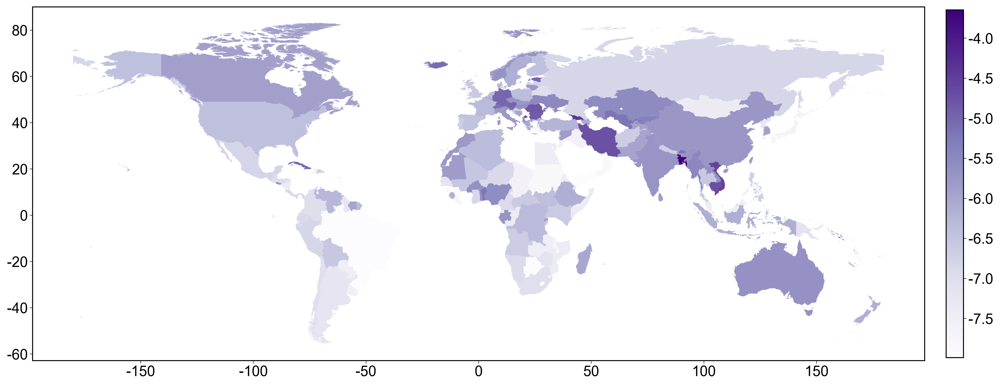

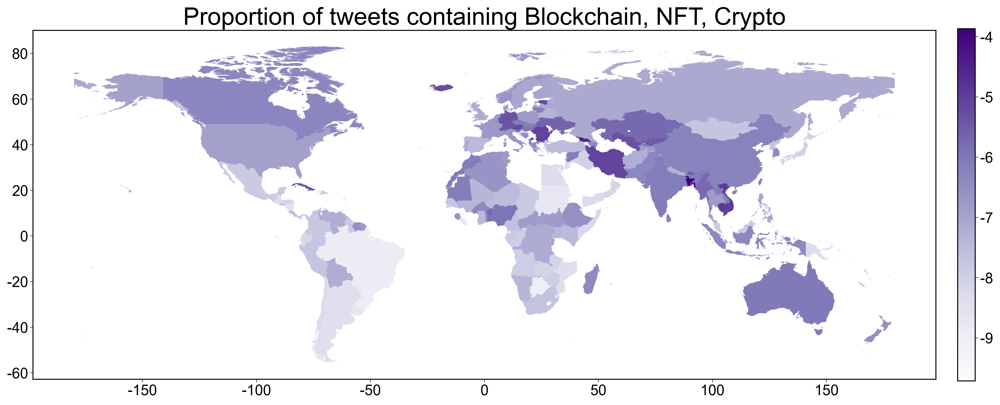

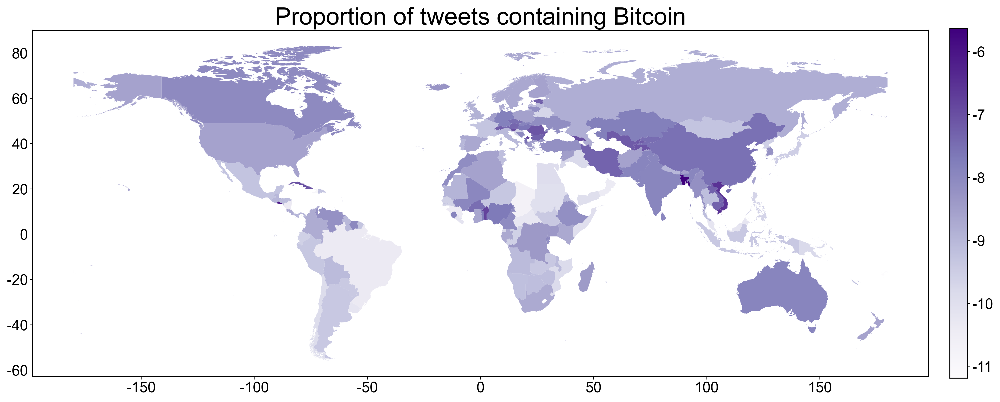

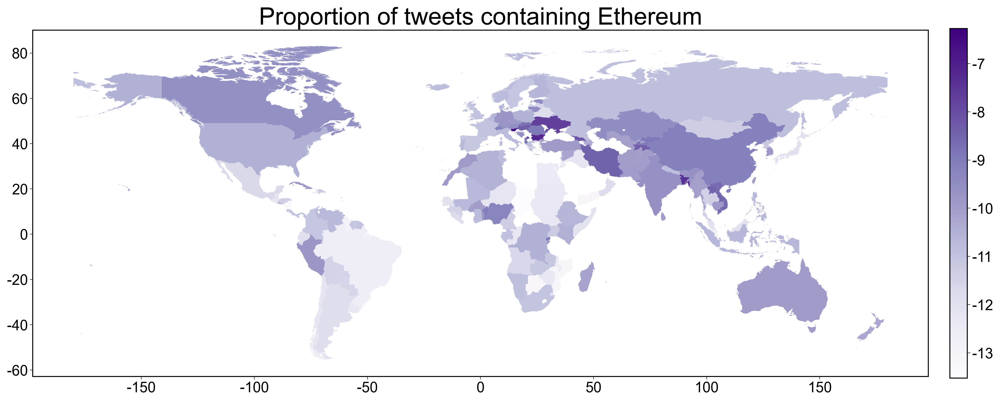

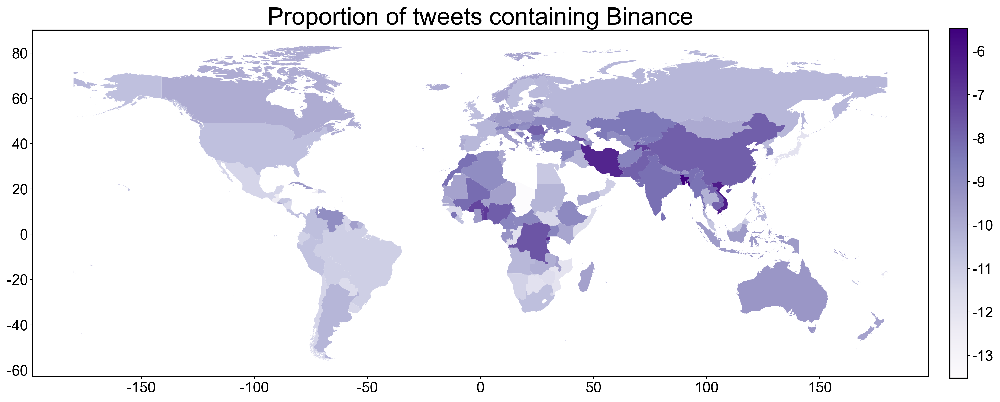

...

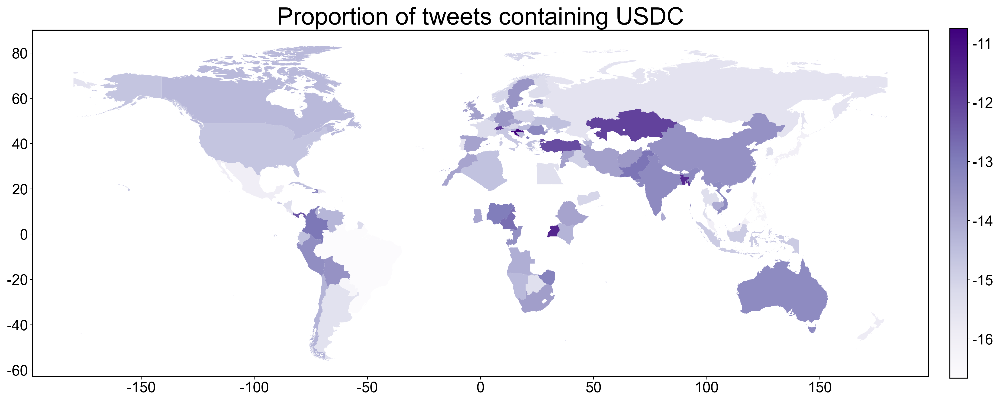

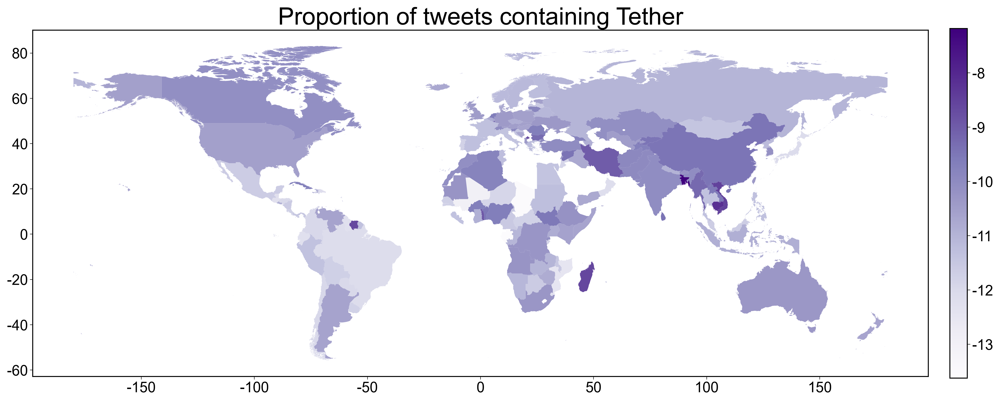

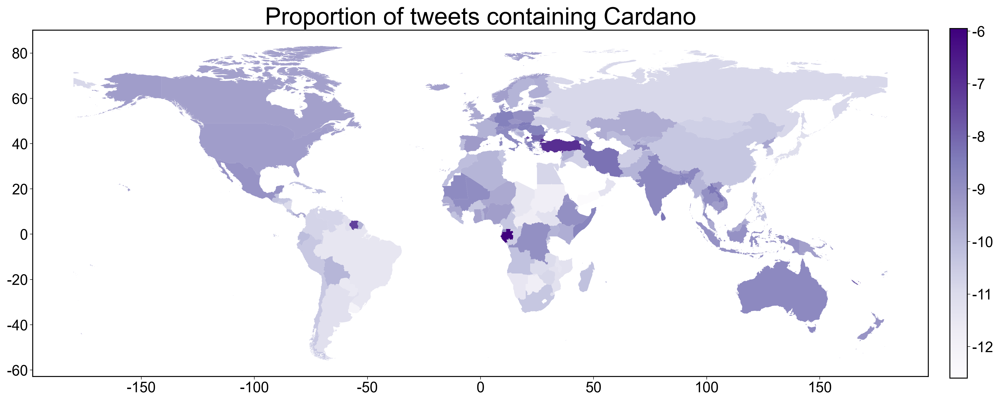

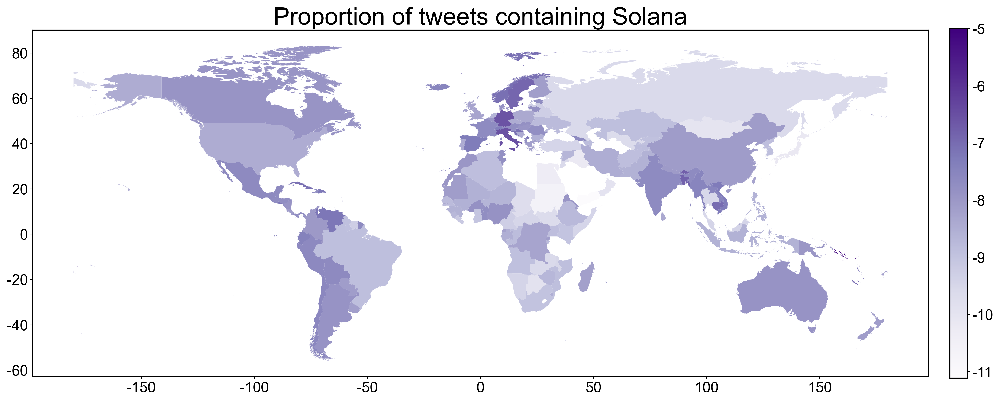

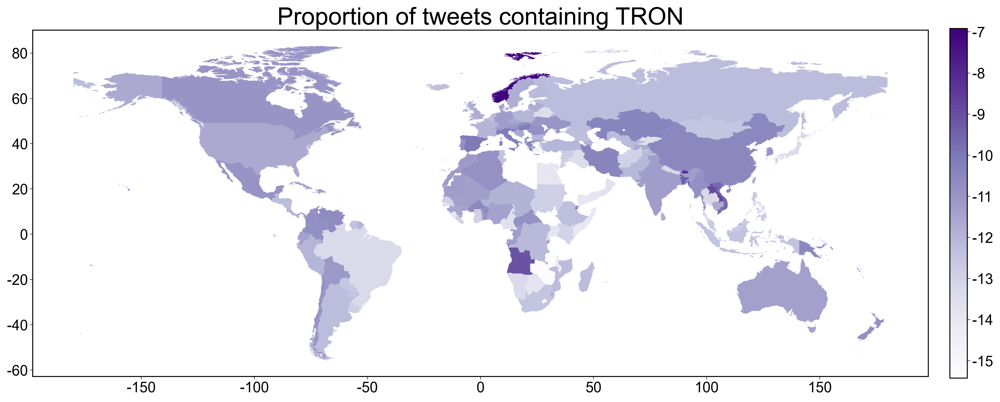

In [561]:
# Plot maps of proportions of tweets
for key in df_tweets.keys():
    gdf_topic_country = df_tweets[key]['country']

    # For all years
    title =  'Proportion of tweets containing ' + key
    plot_maps(gdf_topic_country, 'tweets_proportion_total_log', title, cmap='Purples')

    # # For each year
    # for year in range(2012, 2024):
    #   title =  'Proportion of tweets containing ' + key + ' in ' + str(year)
    #   plot_maps(gdf_topic_country, 'tweets_proportion_' + str(year) + '_log', title, cmap='Purples')

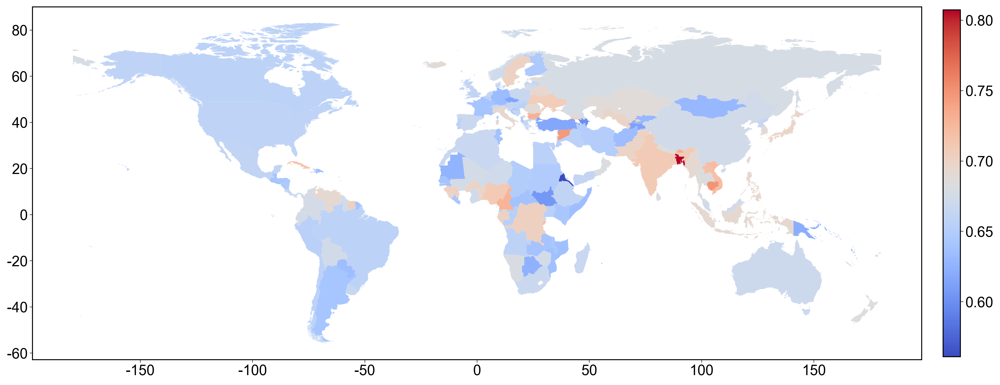

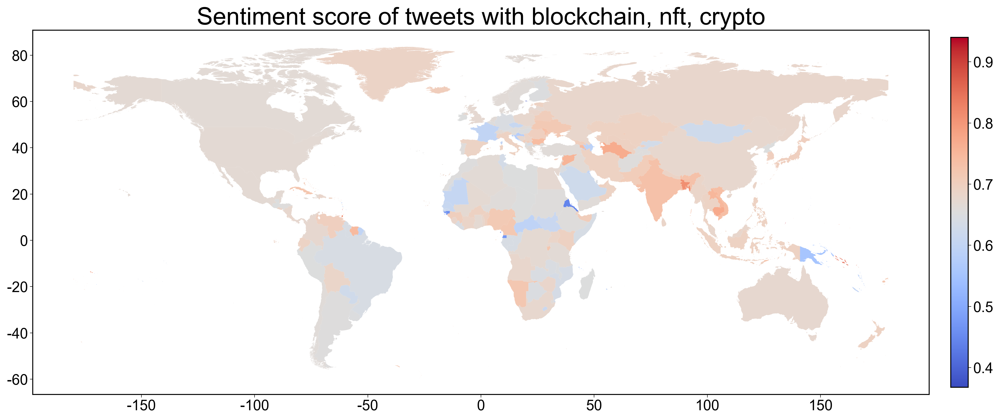

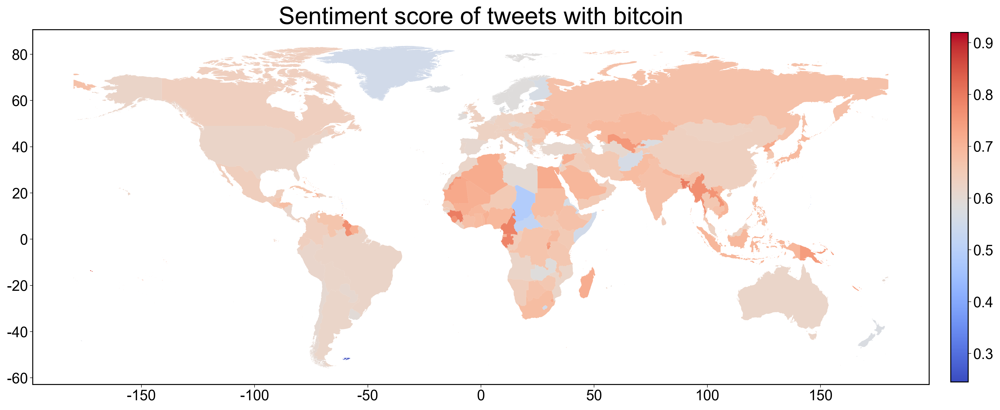

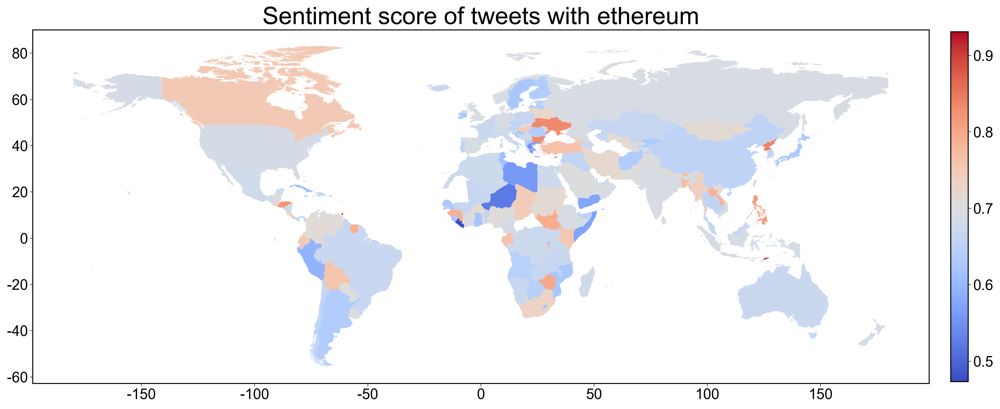

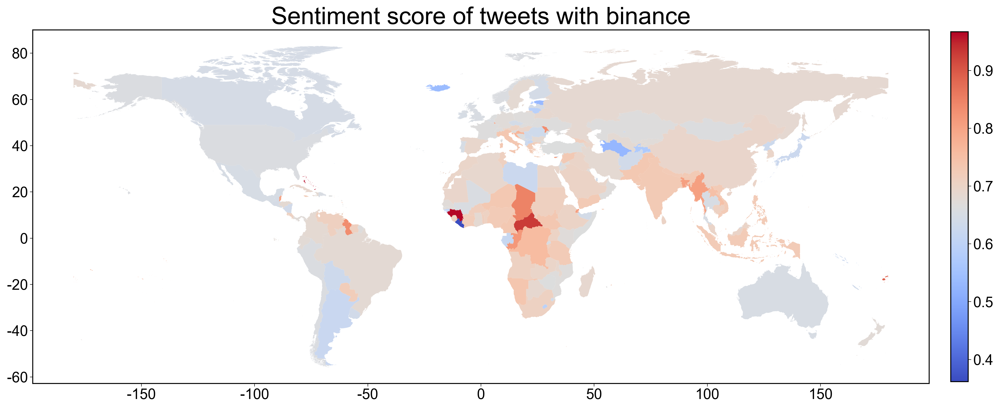

...

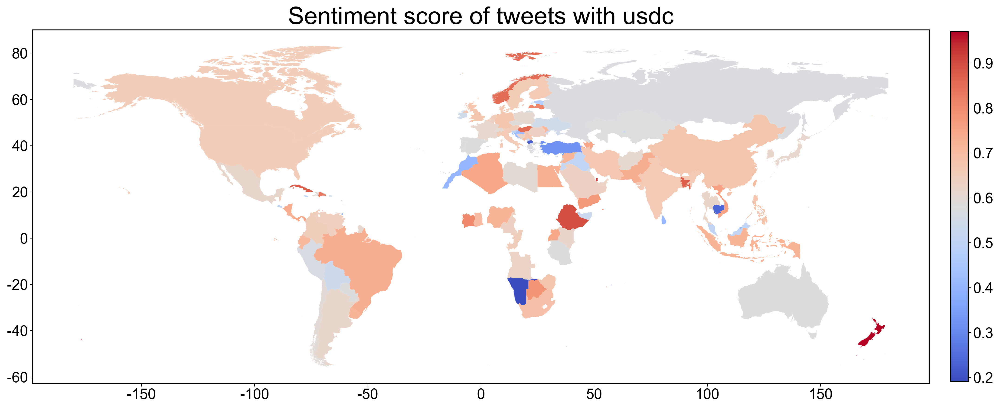

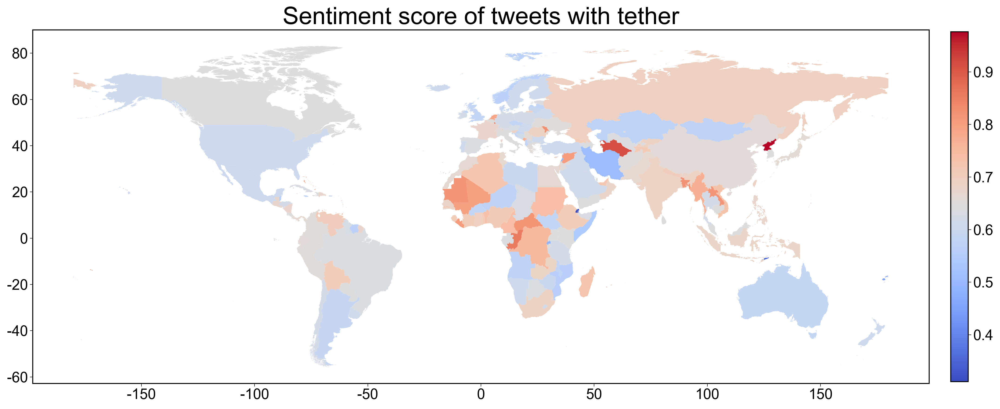

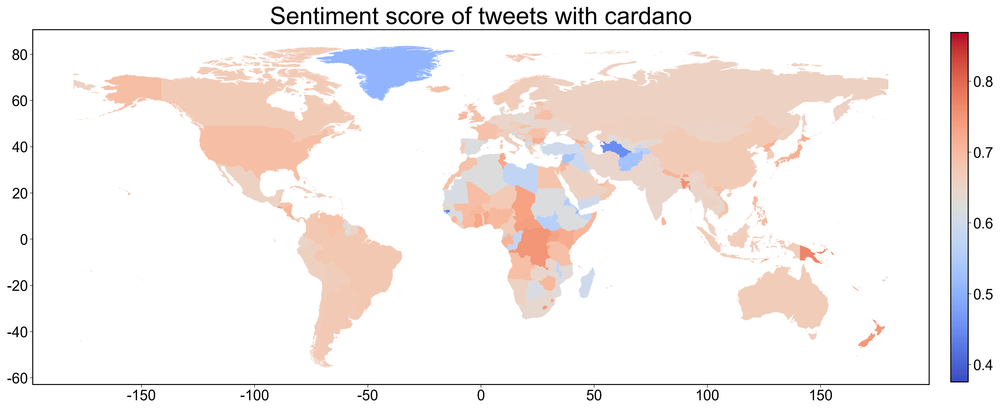

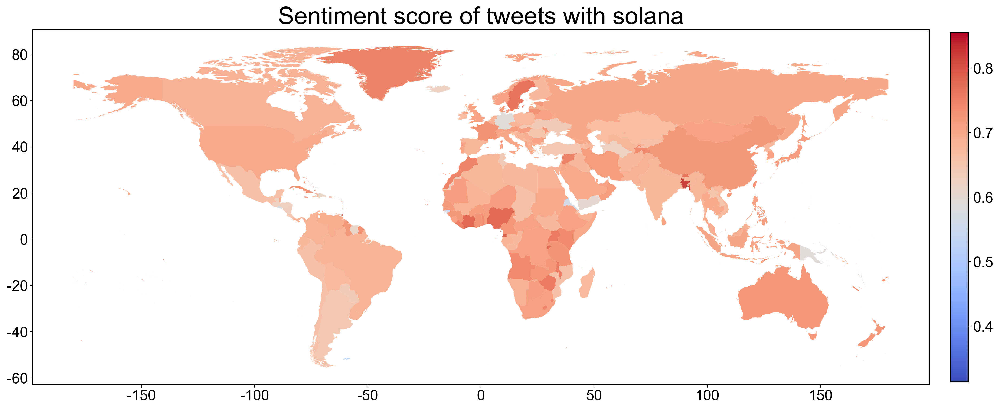

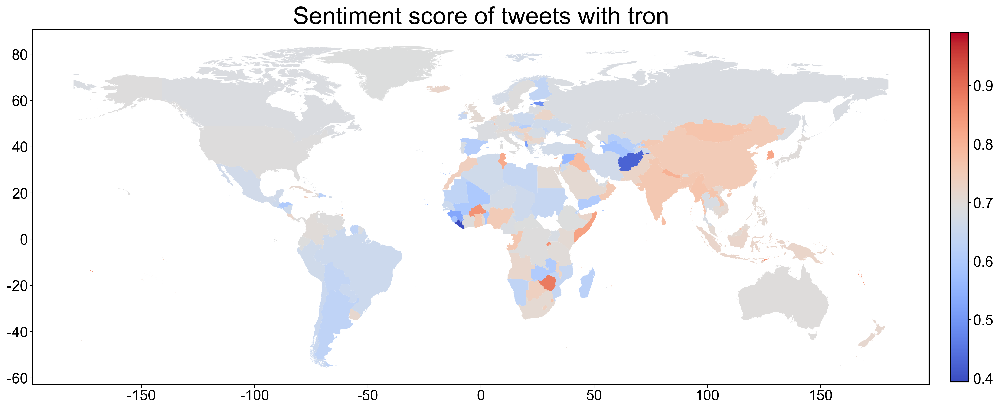

In [566]:
# Plot maps of sentiment scores
for key in df_tweets.keys():
    gdf_topic_country = df_tweets[key]['country']

    # Remove Antarctica
    gdf_topic_country = gdf_topic_country[gdf_topic_country['ISO_A3'] != 'ATA']

    # For all years
    title =  'Sentiment score of tweets with ' + key.lower()
    plot_maps(gdf_topic_country, 'score_total', title, cmap='coolwarm')

    # # For each year
    # for year in range(2012, 2024):
    #   title =  'Sentiment score of tweets with ' + key.lower() + ' in ' + str(year)
    #   plot_maps(gdf_topic_country, 'score_' + str(year), title, cmap='coolwarm')

## 4.2 Linear regression

### GDP and proportion of tweets

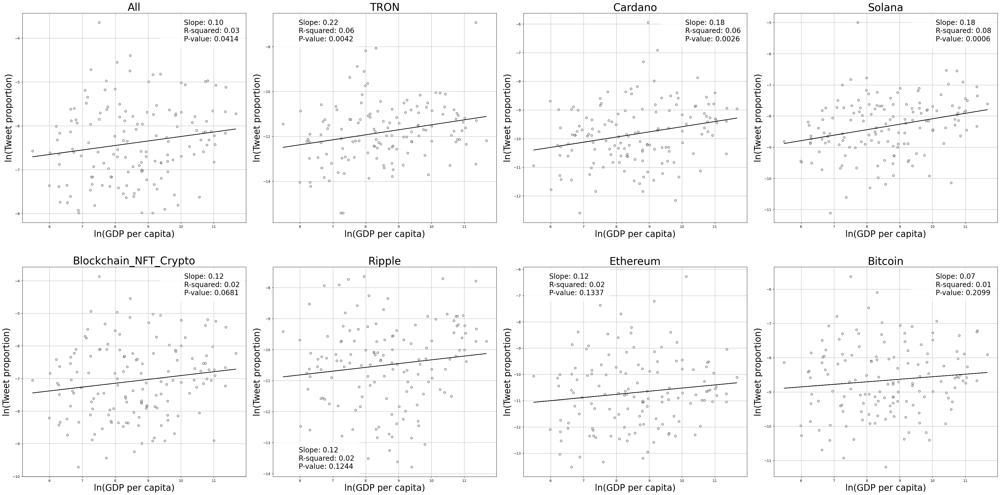

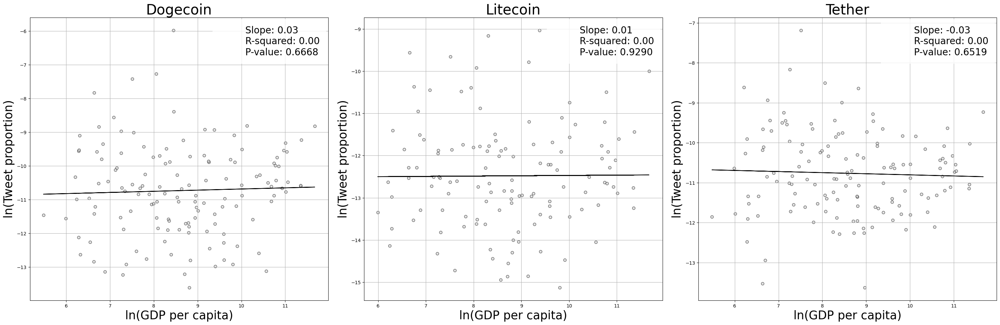

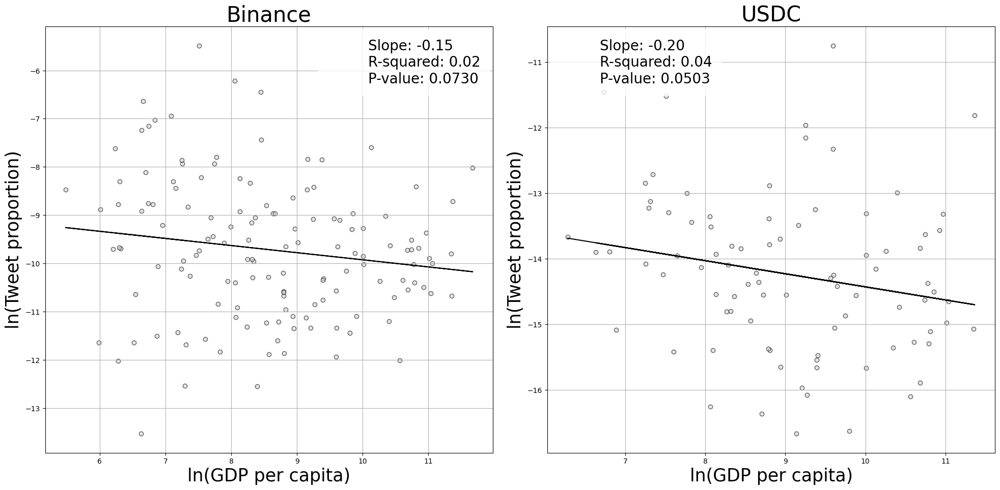

In [252]:
# For all years

topics_combos = {'positive':['any keyword', 'TRON', 'Cardano', 'Solana', 'Blockchain_NFT_Crypto', 'Ripple', 'Ethereum', 'Bitcoin'],
                 'neutral':['Dogecoin', 'Litecoin', 'Tether'],
                 'negative':['Binance', 'USDC']}
cols_num_combos = [4, 3, 2]

col_x, col_y = '2012_2022_gdp_pcap_log', 'tweets_proportion_total_log'
label_x, label_y = 'ln(GDP per capita)', 'ln(Tweet proportion)' 

for i in range(len(topics_combos.keys())):
    type = list(topics_combos.keys())[i]
    topics = topics_combos[type]
    cols_num = cols_num_combos[i]
    var_name_pairs = [[label_x, label_y]] * len(topics)
    var_pairs = []
    for topic in topics:
        gdf_topic_country = df_tweets[topic]['country']
        gdf_topic_country = gdf_topic_country.dropna(subset=[col_x, col_y])
        var_pairs.append([gdf_topic_country[col_x], gdf_topic_country[col_y]])

    filename = 'linear_regression_' + type
    topics = [i.capitalize() for i in topics]
    plot_linear_regression_grid(var_pairs, var_name_pairs, topics, if_normalized=False, cols_num=cols_num, filename=filename)
    

## 4.3 Fisher's z transformed correlation

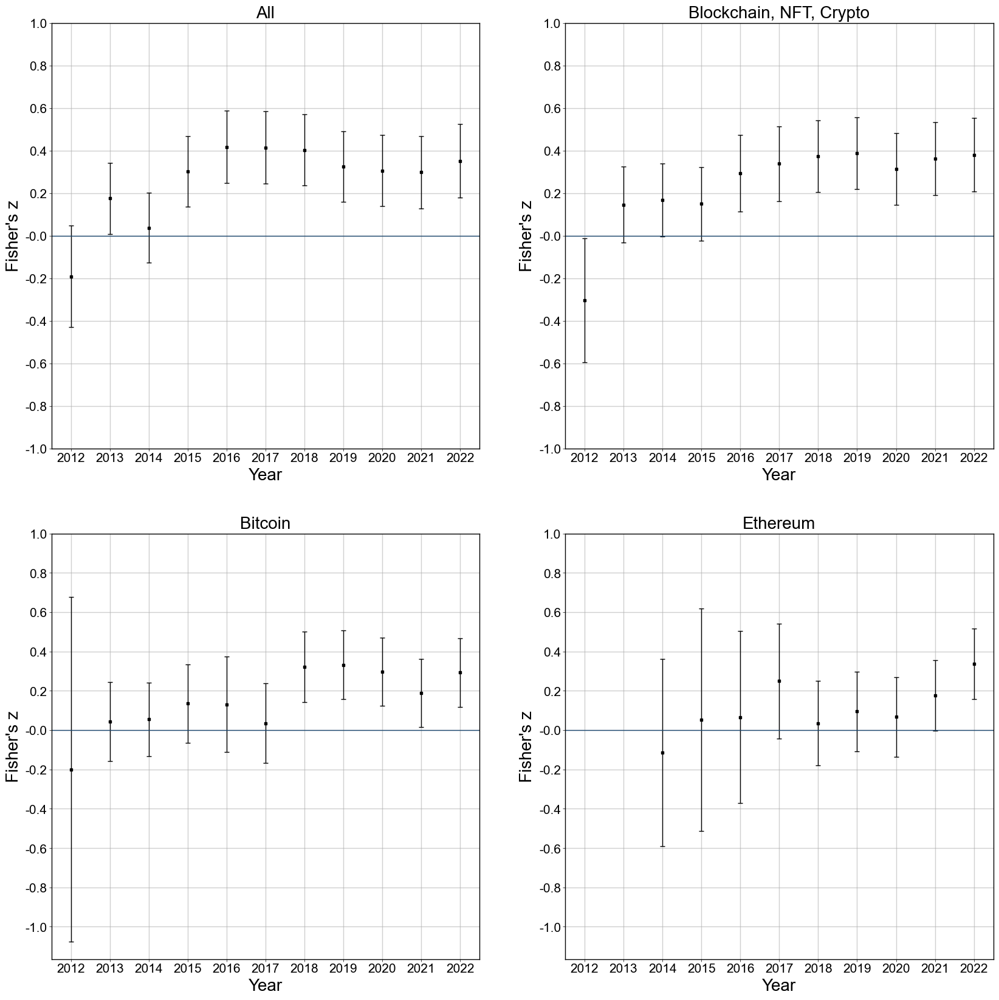

In [571]:
topic_years = {
  'any keyword': list(range(2012, 2023)),
  'Blockchain, NFT, Crypto': list(range(2012, 2023)),
  'Bitcoin': list(range(2012, 2023)),
  'Ethereum': list(range(2012, 2023))
}

# Calculate the number of rows and cols of the maps
cols_num = 2
num_maps = len(topic_years.keys())
rows = int(np.ceil(num_maps / cols_num))

# Create subplots
subplot_size = 10
figsize = (cols_num * subplot_size, rows * subplot_size)
fig, axs = plt.subplots(rows, cols_num, figsize=figsize, sharex='col', sharey='row')

# If only one subplot, make axs a 2D array for iteration
if num_maps == 1:
    axs = np.array([[axs]])


for i in range(len(topic_years.keys())):
    topic = list(topic_years.keys())[i]
    years = topic_years[topic]
    ax = axs.ravel()[i]

    z_ls = []
    p_value_ls = []
    observation_ls = []
    z_low_ls = []
    z_high_ls = []

    tweet_proportion_ls = []

    for year in years:
        sentiment_var = 'score_' + str(year)
        proportion_var = 'tweets_proportion_' + str(year) + '_log'
        gdp_var = str(year) + '_gdp_pcap_log'

        df = df_tweets[topic]['country'].copy()
        dependent_var = proportion_var
        independent_vars = gdp_var

        z, p_value, observation, z_low, z_high = fisher_z(df, dependent_var, independent_vars)
        z_ls.append(z)
        p_value_ls.append(p_value)
        observation_ls.append(observation)
        z_low_ls.append(z_low)
        z_high_ls.append(z_high)

        # ############
        # plot_linear_regression([df[gdp_var], df[proportion_var]], ['gdp', 'tweet proportion'], 'Linear regression of ' + topic + ' in ' + str(year), if_normalized=False)

        ############
        tweet_proportion_ls.append(df[proportion_var].mean())

    # Plot the results
    subtitle = topic
    if topic == 'any keyword':
        subtitle = 'All'
    plot_fisher_z(years, z_ls, z_low_ls, z_high_ls, subtitle, ax)
    for ax in axs.flat:
        ax.tick_params(labelbottom=True, labelleft=True)
    # plt.suptitle('Fisher\'s z transformed correlation coefficient across years', fontsize=25)
    # plt.subplots_adjust(top=0.92)
    plt.savefig('./figures/spatial/correlation/fisher_z_gdp_tweet_proportion.png', dpi=300, bbox_inches='tight')

    # ############
    # fig = plt.figure(figsize=(10, 5), dpi=300)
    # plt.plot(years, tweet_proportion_ls, linestyle='-', color='black', linewidth=1)

## 4.4 SEM regression model

### Choose Weights Algorithm

In [649]:
gdf = gpd.GeoDataFrame(df_tweets['any keyword']['country'].copy(), geometry='geometry')
y_col = 'tweets_proportion_total_log'
y = gdf[y_col]
compute_mi(gdf, y, 'knn', k=2)

Moran's I: 0.3683
p-value: 0.0000
Expected I under random spatial pattern: -0.0067


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 10 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


### Explain Attention: GDP

In [356]:
topic = 'any keyword'
years = ['total'] + list(range(2012, 2023))

for year in years:
    print('\n')
    print('#########' + str(year) + '#########')
    sentiment_var = 'score_' + str(year)
    proportion_var = 'tweets_proportion_' + str(year) + '_log'
    gdp_var = str(year) + '_gdp_pcap_log'
    if year == 'total':
        gdp_var = '2012_2022_gdp_pcap_log'

    df = df_tweets[topic]['country'].copy()
    gdf = gpd.GeoDataFrame(df, geometry='geometry')
    gdf.dropna(subset=[proportion_var, gdp_var], inplace=True)
    y, dependent_var = gdf[proportion_var].to_numpy(), proportion_var
    X, independent_vars = gdf[gdp_var].to_numpy().reshape(-1, 1), [gdp_var]

    geo_regression('sem', y, X, gdf, dependent_var, independent_vars, if_standardize=True)



#########total#########
VIF for const: 1.0


VIF for 2012_2022_gdp_pcap_log: 1.0000000000000002


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: GM SPATIALLY WEIGHTED LEAST SQUARES
------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :tweets_proportion_total_log                Number of Observations:         145
Mean dependent var  :      0.0000                Number of Variables   :           2
S.D. dependent var  :      1.0035                Degrees of Freedom    :         143
Pseudo R-squared    :      0.0288

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT         0.00993         0.11596         0.08566         0.93174
2012_2022_gdp_pcap_log         0.12499

c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 8 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully 

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: GM SPATIALLY WEIGHTED LEAST SQUARES
------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :tweets_proportion_2017_log                Number of Observations:         138
Mean dependent var  :     -0.0000                Number of Variables   :           2
S.D. dependent var  :      1.0036                Degrees of Freedom    :         136
Pseudo R-squared    :      0.1537

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT         0.00581         0.09419         0.06167         0.95083
   2017_gdp_pcap_log         0.39600         0.08850         4.47452         0.00001
              lambda         0.18550    
-------------

c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 6 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 6 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully 

### Explain Sentiment: GDP, Tweet proportion, Ban

## 4.5 OLS regression model

### Explain Attention: GDP



#########total#########
                                 OLS Regression Results                                
Dep. Variable:     tweets_proportion_total_log   R-squared:                       0.029
Model:                                     OLS   Adj. R-squared:                  0.022
Method:                          Least Squares   F-statistic:                     4.234
Date:                         Thu, 23 Nov 2023   Prob (F-statistic):             0.0414
Time:                                 22:18:07   Log-Likelihood:                -184.91
No. Observations:                          145   AIC:                             373.8
Df Residuals:                              143   BIC:                             379.8
Df Model:                                    1                                         
Covariance Type:                     nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
---

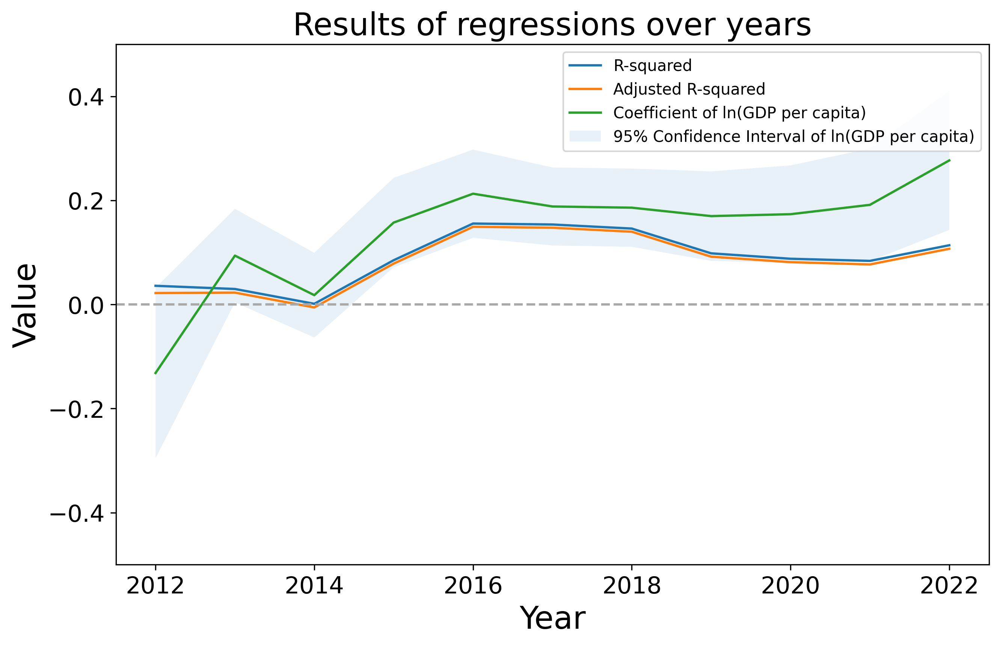

In [141]:
topic = 'any keyword'
years = ['total'] + list(range(2012, 2023))

stats_dict = {}

for year in years:
  print('\n')
  print('#########' + str(year) + '#########')
  sentiment_var = 'score_' + str(year)
  proportion_var = 'tweets_proportion_' + str(year) + '_log'
  gdp_var = str(year) + '_gdp_pcap_log'
  if year == 'total':
    gdp_var = '2012_2022_gdp_pcap_log'

  df = df_tweets[topic]['country'].copy()
  dependent_var = proportion_var
  independent_vars = [gdp_var]

  stats = ols_regression(df, dependent_var, independent_vars)
  if year != 'total':
    stats_dict[year] = stats

# Plot the results
independent_vars_ls = ['ln(GDP per capita)']
filename = 'ols_regression_gdp_tweet_proportion'
plot_ols_results(independent_vars_ls, stats_dict, filename)

### Explain Sentiment: GDP, Tweet proportion, Ban

In [77]:
topic = 'any keyword'
years = ['total'] + list(range(2012, 2023))

for year in years:
  print('#########' + str(year) + '#########')
  ban_var = 'ban_status_binary'
  sentiment_var = 'score_' + str(year)
  proportion_var = 'tweets_proportion_' + str(year) + '_log'
  gdp_var = str(year) + '_gdp_pcap_log'
  if year == 'total':
    gdp_var = '2012_2022_gdp_pcap_log'

  df = df_tweets[topic]['country'].copy()
  dependent_var = sentiment_var
  independent_vars = [gdp_var, proportion_var]      # Add: ban_var

  ols_regression(df, dependent_var, independent_vars)

#########total#########
                            OLS Regression Results                            
Dep. Variable:            score_total   R-squared:                       0.200
Model:                            OLS   Adj. R-squared:                  0.189
Method:                 Least Squares   F-statistic:                     17.75
Date:                Thu, 23 Nov 2023   Prob (F-statistic):           1.32e-07
Time:                        21:24:31   Log-Likelihood:                 310.69
No. Observations:                 145   AIC:                            -615.4
Df Residuals:                     142   BIC:                            -606.5
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------

## 4.6 Spatial clustering

### K-means

In [809]:
features = ['tweets_proportion_total_log', 'score_total', '2012_2022_gdp_pcap_log']

# clustering
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score

df = df_tweets['any keyword']['country'].copy()
df.dropna(subset=features, inplace=True)
X = df[features]
scaler = StandardScaler()
# K-means clustering
X_scaled = scaler.fit_transform(X)
kmeans = KMeans(n_clusters=3, random_state=0).fit(X_scaled)
df['cluster'] = kmeans.labels_

In [1170]:
# Silhouette score
print(silhouette_score(X_scaled, kmeans.labels_))

0.31215557322328147


### Country list

In [1013]:
# Country names
cluster_1_countries = df[df['cluster']==0]['ADMIN'].tolist()
cluster_2_countries = df[df['cluster']==1]['ADMIN'].tolist()
cluster_3_countries = df[df['cluster']==2]['ADMIN'].tolist()

print("Cluster 1:", cluster_1_countries)
print("Cluster 2:", cluster_2_countries)
print("Cluster 3:", cluster_3_countries)

Cluster 1: ['Burundi', 'Benin', 'Burkina Faso', 'Bangladesh', 'Bulgaria', 'Bhutan', 'Cameroon', 'Democratic Republic of the Congo', 'Cuba', 'Gabon', 'Georgia', 'Indonesia', 'India', 'Cambodia', 'Laos', 'Sri Lanka', 'Morocco', 'Madagascar', 'Myanmar', 'Nigeria', 'Pakistan', 'Philippines', 'Romania', 'Rwanda', 'Solomon Islands', 'Sierra Leone', 'Suriname', 'Syria', 'Togo', 'Ukraine', 'Uzbekistan', 'Vietnam', 'Samoa']
Cluster 2: ['Afghanistan', 'Angola', 'Argentina', 'American Samoa', 'Azerbaijan', 'Belarus', 'Bolivia', 'Brazil', 'Botswana', 'Central African Republic', 'Republic of Congo', 'Colombia', 'Djibouti', 'Dominican Republic', 'Algeria', 'Ecuador', 'Egypt', 'Ethiopia', 'Fiji', 'Ghana', 'Guinea', 'Gambia', 'Equatorial Guinea', 'Guatemala', 'Guyana', 'Honduras', 'Haiti', 'Iraq', 'Jordan', 'Kenya', 'Kyrgyzstan', 'Liberia', 'Mexico', 'Mali', 'Mongolia', 'Mozambique', 'Mauritania', 'Malawi', 'Malaysia', 'Namibia', 'Niger', 'Nicaragua', 'Nepal', 'Oman', 'Peru', 'Papua New Guinea', 'Para

In [1015]:
# GDP per capita
print("Cluster 1:\n", df[df['cluster']==0]['2012_2022_gdp_pcap'].describe())
print("Cluster 2:\n", df[df['cluster']==1]['2012_2022_gdp_pcap'].describe())
print("Cluster 3:\n", df[df['cluster']==2]['2012_2022_gdp_pcap'].describe())

Cluster 1:
 count       33.000000
mean      3075.595254
std       2811.690022
min        240.087148
25%       1192.022342
50%       2256.593178
75%       3887.241865
max      11795.697387
Name: 2012_2022_gdp_pcap, dtype: float64
Cluster 2:
 count       62.000000
mean      4222.720112
std       4203.289617
min        399.656699
25%       1106.604738
50%       2748.896386
75%       6116.255730
max      20064.097227
Name: 2012_2022_gdp_pcap, dtype: float64
Cluster 3:
 count        50.000000
mean      33879.133414
std       25430.121322
min        4099.106571
25%       14663.783442
50%       26785.457496
75%       48335.310576
max      117302.842950
Name: 2012_2022_gdp_pcap, dtype: float64


In [1016]:
# Sentiment score
print("Cluster 1:\n", df[df['cluster']==0]['score_total'].describe())
print("Cluster 2:\n", df[df['cluster']==1]['score_total'].describe())
print("Cluster 3:\n", df[df['cluster']==2]['score_total'].describe())

Cluster 1:
 count    33.000000
mean      0.705986
std       0.027606
min       0.664015
25%       0.694120
50%       0.702189
75%       0.716088
max       0.807411
Name: score_total, dtype: float64
Cluster 2:
 count    62.000000
mean      0.651137
std       0.023469
min       0.576725
25%       0.638181
50%       0.653852
75%       0.669808
max       0.702456
Name: score_total, dtype: float64
Cluster 3:
 count    50.000000
mean      0.664504
std       0.021319
min       0.609284
25%       0.656318
50%       0.664290
75%       0.679861
max       0.701169
Name: score_total, dtype: float64


In [1020]:
# Tweet proportion
print("Cluster 1:\n", df[df['cluster']==0]['tweets_proportion_total'].describe())
print("Cluster 2:\n", df[df['cluster']==1]['tweets_proportion_total'].describe())
print("Cluster 3:\n", df[df['cluster']==2]['tweets_proportion_total'].describe())

Cluster 1:
 count    33.000000
mean      0.004974
std       0.004696
min       0.000976
25%       0.002564
50%       0.003611
75%       0.005745
max       0.026084
Name: tweets_proportion_total, dtype: float64
Cluster 2:
 count    62.000000
mean      0.001019
std       0.000749
min       0.000339
25%       0.000574
50%       0.000773
75%       0.001286
max       0.004782
Name: tweets_proportion_total, dtype: float64
Cluster 3:
 count    50.000000
mean      0.002797
std       0.001861
min       0.000489
25%       0.001432
50%       0.002169
75%       0.003360
max       0.008688
Name: tweets_proportion_total, dtype: float64


In [986]:
# Crypto ban status
df_cluster_ban = df.dropna(subset=['ban_status_nominal'])
legal_countries = df_cluster_ban[df_cluster_ban['ban_status_nominal']=='Legal']['ISO_A3'].tolist()
partial_ban_countries = df_cluster_ban[df_cluster_ban['ban_status_nominal']=='Partial Ban']['ISO_A3'].tolist()
general_ban_countries = df_cluster_ban[df_cluster_ban['ban_status_nominal']=='General Ban']['ISO_A3'].tolist()

print(len(legal_countries))
print(len(partial_ban_countries))
print(len(general_ban_countries))

27
18
8


In [995]:
group1 = [cluster_1_countries, cluster_2_countries, cluster_3_countries]
group2 = [legal_countries, partial_ban_countries, general_ban_countries]
xticklabels=['Legal', 'Partial Ban', 'General Ban']
yticklabels=['Cluster 1', 'Cluster 2', 'Cluster 3']

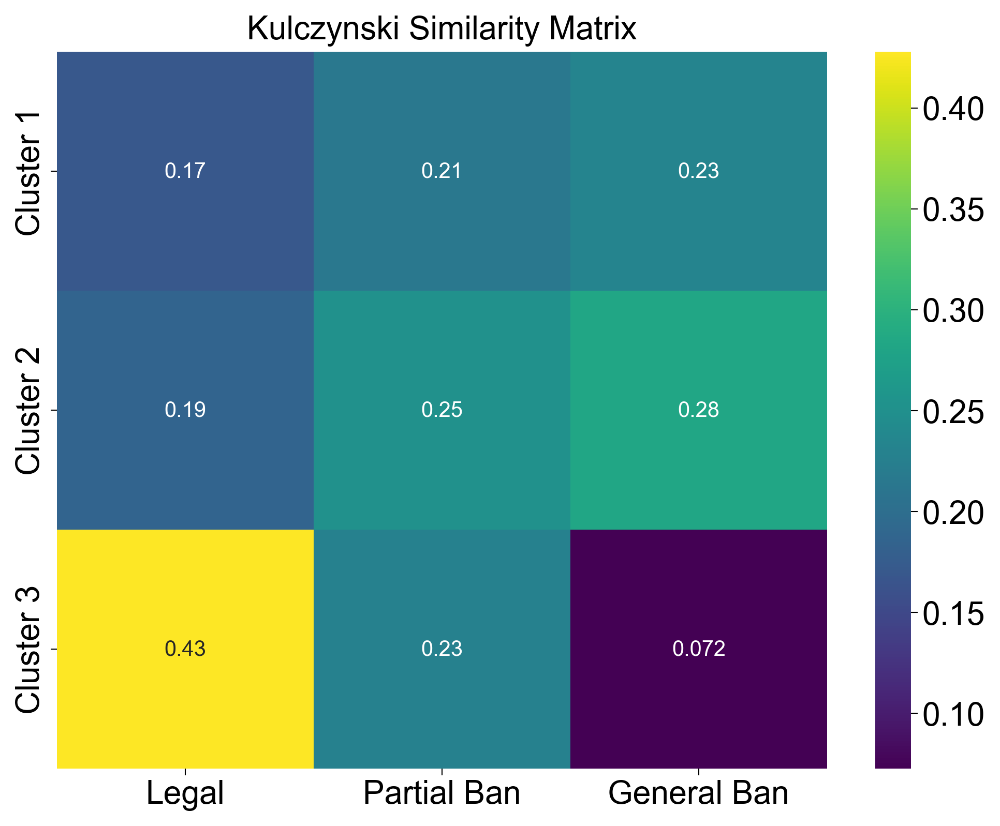

In [996]:
# Similarity matrix

def kulczynski_similarity(set1, set2):
    intersection = len(set(set1).intersection(set2))
    return 0.5 * (intersection / len(set1) + intersection / len(set2)) if intersection > 0 else 0

similarity_matrix = np.zeros((len(group1), len(group2)))

for i, list1 in enumerate(group1):
    for j, list2 in enumerate(group2):
        similarity_matrix[i][j] = kulczynski_similarity(list1, list2)

plt.figure(figsize=(8, 6), dpi=300)
sns.heatmap(similarity_matrix, annot=True, cmap='viridis', 
            xticklabels=xticklabels, yticklabels=yticklabels)
plt.title('Kulczynski Similarity Matrix')
plt.show()

Text(0, 0.5, 'Crypto ban status')

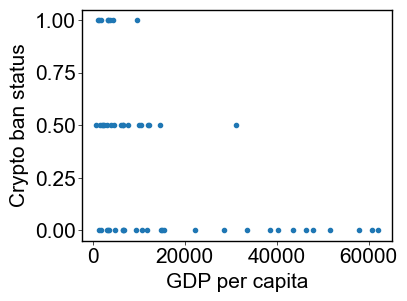

In [1117]:
# scatter
plt.scatter(df['2012_2022_gdp_pcap'], df['ban_status_ordinal'])
plt.xlabel('GDP per capita')
plt.ylabel('Crypto ban status')

c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\geopandas\geodataframe.py:1474: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\geopandas\geodataframe.py:1474: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  result = super().__getitem__(key)


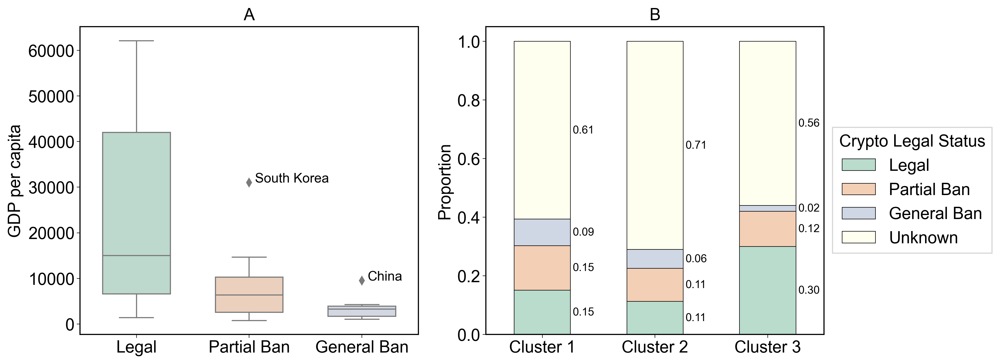

In [1196]:
color_mapping = {
    'Legal': '#B9DCCC',
    'Partial Ban': '#F3CFB6',
    'General Ban': '#CFD6E4'
}

fig, axes = plt.subplots(1, 2, figsize=(12, 5), dpi=300)

# boxplot
ax1 = axes[0]
order = ['Legal', 'Partial Ban', 'General Ban']
sns.boxplot(ax=ax1, x='ban_status_nominal', y='2012_2022_gdp_pcap', 
            data=df, order=order, width=0.6, palette=color_mapping)
ax1.set_ylabel('GDP per capita', fontsize=15)
ax1.set_xlabel('')
ax1.set_xticklabels(['Legal', 'Partial Ban', 'General Ban'], rotation=0, fontsize=15)
# add annotation to the outliers
outliers_a = df[df['ban_status_nominal']=='Partial Ban'][df['2012_2022_gdp_pcap'] > 20000]
outliers_b = df[df['ban_status_nominal']=='General Ban'][df['2012_2022_gdp_pcap'] > 9000]
for i in range(len(outliers_a)):
    ax1.annotate(outliers_a.iloc[i]['ADMIN'], (outliers_a.iloc[i]['ban_status_ordinal']+0.55, outliers_a.iloc[i]['2012_2022_gdp_pcap']), fontsize=12)
for i in range(len(outliers_b)):
    ax1.annotate(outliers_b.iloc[i]['ADMIN'], (outliers_b.iloc[i]['ban_status_ordinal']+1.05, outliers_b.iloc[i]['2012_2022_gdp_pcap']), fontsize=12)
ax1.set_title('A')


# barplot

df_temp = df.copy()
df_temp['ban_status_nominal'].fillna('Unknown', inplace=True)

cluster_1_ban = df_temp[df_temp['cluster']==0]['ban_status_nominal'].value_counts()
cluster_2_ban = df_temp[df_temp['cluster']==1]['ban_status_nominal'].value_counts()
cluster_3_ban = df_temp[df_temp['cluster']==2]['ban_status_nominal'].value_counts()

cluster_1_ban = cluster_1_ban / cluster_1_ban.sum()
cluster_2_ban = cluster_2_ban / cluster_2_ban.sum()
cluster_3_ban = cluster_3_ban / cluster_3_ban.sum()

df_cluster_ban = pd.DataFrame({'Cluster 1': cluster_1_ban, 'Cluster 2': cluster_2_ban, 'Cluster 3': cluster_3_ban})
df_cluster_ban = df_cluster_ban.T
df_cluster_ban = df_cluster_ban[['Legal', 'Partial Ban', 'General Ban', 'Unknown']]

ax2 = axes[1]
df_cluster_ban.plot(ax=ax2, kind='bar', stacked=True, width=0.5, 
                    edgecolor='black', linewidth=0.5, alpha=1,
                    color=[color_mapping['Legal'], color_mapping['Partial Ban'], color_mapping['General Ban'], 'ivory'], rot=0)
ax2.set_ylabel('Proportion', fontsize=15)
ax2.legend(title='Crypto Legal Status', loc='upper left', bbox_to_anchor=(1, 0.7), 
           fancybox=False, fontsize=15, title_fontsize=15)
ax2.set_xticklabels(['Cluster 1', 'Cluster 2', 'Cluster 3'], rotation=0, fontsize=15)
ax2.set_title('B')
# add annotation
for i in range(len(df_cluster_ban)):
    for j in range(len(df_cluster_ban.columns)):
        ax2.annotate(
            f"{df_cluster_ban.iloc[i, j]:.2f}",
            (i + 0.27, df_cluster_ban.iloc[i, :j].sum() + df_cluster_ban.iloc[i, j] / 2), 
            ha='left',
            va='center',
            fontsize=10,
            color='black'
        )

plt.savefig('./figures/spatial/ban_status/cluster_ban_status.png', dpi=300, bbox_inches='tight')

In [1202]:
# spearman correlation
df = df_tweets['any keyword']['country'].copy()
df.dropna(subset=['2012_2022_gdp_pcap', 'ban_status_ordinal'], inplace=True)
x = df['2012_2022_gdp_pcap']
y = df['ban_status_ordinal']
print(spearmanr(x, y))

# spearman correlation
df = df_tweets['any keyword']['country'].copy()
df.dropna(subset=['ban_status_ordinal'], inplace=True)
x = df['tweets_proportion_total']
y = df['ban_status_ordinal']
print(spearmanr(x, y))

# spearman correlation
df = df_tweets['any keyword']['country'].copy()
df.dropna(subset=['ban_status_ordinal'], inplace=True)
x = df['score_total']
y = df['ban_status_ordinal']
print(spearmanr(x, y))

SignificanceResult(statistic=-0.5302675960026857, pvalue=4.429399663198229e-05)
SignificanceResult(statistic=0.07587929616440105, pvalue=0.5891854270822036)
SignificanceResult(statistic=0.1621864488192315, pvalue=0.24593413204544137)


In [1206]:
print(df[df['ban_status_nominal']=='Legal']['2012_2022_gdp_pcap'].describe())
print(df[df['ban_status_nominal']=='Partial Ban']['2012_2022_gdp_pcap'].describe())
print(df[df['ban_status_nominal']=='General Ban']['2012_2022_gdp_pcap'].describe())

count       27.000000
mean     24009.788479
std      20669.429784
min       1416.045244
25%       6620.825602
50%      14983.711195
75%      42022.163777
max      62104.260871
Name: 2012_2022_gdp_pcap, dtype: float64
count       18.000000
mean      7635.753531
std       7164.641350
min        778.479734
25%       2568.116711
50%       6351.273373
75%      10289.010964
max      31038.329879
Name: 2012_2022_gdp_pcap, dtype: float64
count       8.000000
mean     3565.185621
std      2683.922196
min      1047.997401
25%      1721.922691
50%      3298.382024
75%      3934.217943
max      9538.004787
Name: 2012_2022_gdp_pcap, dtype: float64


### Scatter

C:\Users\Moon\AppData\Local\Temp\ipykernel_112488\2981854046.py:10: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot(grid[0, 0])
C:\Users\Moon\AppData\Local\Temp\ipykernel_112488\2981854046.py:13: UserWarning: You passed a edgecolor/edgecolors ('Blues') for an unfilled marker ('x').  Matplotlib is ignoring the edgecolor in favor of the facecolor.  This behavior may change in the future.
  scatter = ax1.scatter(df['2012_2022_gdp_pcap_log'], df['tweets_proportion_total_log'], c=df['category'],


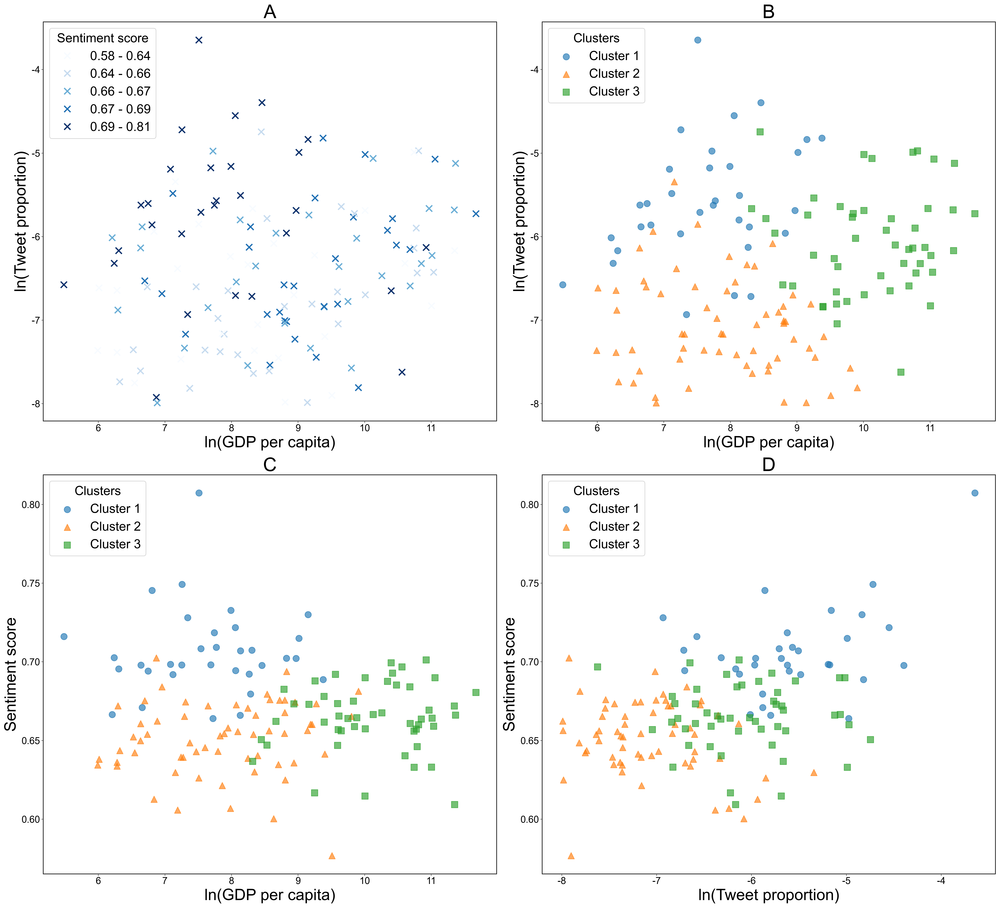

In [1043]:
colors = ["#F39657", "#70A8D6", "#9EBC7A"]
cmap = mcolors.LinearSegmentedColormap.from_list("cluster_cmap", colors)

# Create a figure with subplots
fig, axs = plt.subplots(figsize=(22, 20), dpi=300)
grid = plt.GridSpec(2, 2)   # wspace, hspace


# Plot 1
ax1 = plt.subplot(grid[0, 0])
category_num = 5
df['category'], bins = pd.qcut(df['score_total'], category_num, labels=False, retbins=True)
scatter = ax1.scatter(df['2012_2022_gdp_pcap_log'], df['tweets_proportion_total_log'], c=df['category'], 
                         alpha=1, s=100, edgecolor='Blues', linewidths=2, cmap='Blues', marker='x')


ax1.set_xlabel('ln(GDP per capita)', fontsize=25)
ax1.set_ylabel('ln(Tweet proportion)', fontsize=25)

# change the size of the first subplot
box = ax1.get_position()
ax1.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Manually changing legend labels for Plot 1
bin_labels = [f"{round(bins[i], 2)} - {round(bins[i+1], 2)}" for i in range(len(bins)-1)]
handles, labels = scatter.legend_elements()
for handle in handles:
    handle.set_markersize(10)
new_labels = ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5']  # New labels
legend1 = ax1.legend(handles, bin_labels, fontsize=20, loc='upper left', 
                     title='Sentiment score', title_fontsize=20)

ax1.set_title('A', fontsize=30)



# Plot 2
ax2 = plt.subplot(grid[0, 1])

markers = ['o', '^', 's']
cluster_labels = ['Cluster 1', 'Cluster 2', 'Cluster 3']
legend_handles = []

for cluster in np.unique(df['cluster']):
    subset = df[df['cluster'] == cluster]
    scatter = ax2.scatter(subset['2012_2022_gdp_pcap_log'], subset['tweets_proportion_total_log'], 
                    alpha=0.65, s=100,
                    marker=markers[cluster], label=cluster_labels[cluster])
    legend_handles.append(scatter)

ax2.legend(handles=legend_handles, fontsize=20, loc='upper left', 
           title='Clusters', title_fontsize=20)

# change the size of the first subplot
box = ax2.get_position()
ax2.set_position([box.x0, box.y0, box.width * 0.8, box.height])

ax2.set_xlabel('ln(GDP per capita)', fontsize=25)
ax2.set_ylabel('ln(Tweet proportion)', fontsize=25)
ax2.set_title('B', fontsize=30)


# Plot 3
ax3 = plt.subplot(grid[1, 0])

markers = ['o', '^', 's']
cluster_labels = ['Cluster 1', 'Cluster 2', 'Cluster 3']
legend_handles = []

for cluster in np.unique(df['cluster']):
    subset = df[df['cluster'] == cluster]
    scatter = ax3.scatter(subset['2012_2022_gdp_pcap_log'], subset['score_total'], 
                    alpha=0.65, s=100,
                    marker=markers[cluster], label=cluster_labels[cluster])
    legend_handles.append(scatter)

ax3.legend(handles=legend_handles, fontsize=20, loc='upper left', 
           title='Clusters', title_fontsize=20)

ax3.set_xlabel('ln(GDP per capita)', fontsize=25)
ax3.set_ylabel('Sentiment score', fontsize=25)
ax3.set_title('C', fontsize=30)


# Plot 4
ax4 = plt.subplot(grid[1, 1])

markers = ['o', '^', 's']
cluster_labels = ['Cluster 1', 'Cluster 2', 'Cluster 3']
legend_handles = []

for cluster in np.unique(df['cluster']):
    subset = df[df['cluster'] == cluster]
    scatter = ax4.scatter(subset['tweets_proportion_total_log'], subset['score_total'], 
                    alpha=0.65, s=100, 
                    marker=markers[cluster], label=cluster_labels[cluster])
    legend_handles.append(scatter)

ax4.legend(handles=legend_handles, fontsize=20, loc='upper left', 
           title='Clusters', title_fontsize=20)

ax4.set_xlabel('ln(Tweet proportion)', fontsize=25)
ax4.set_ylabel('Sentiment score', fontsize=25)
ax4.set_title('D', fontsize=30)



plt.tight_layout()
plt.savefig('./figures/spatial/clustering/scatter.png', dpi=300, bbox_inches='tight')
plt.show()

### Map

In [450]:
gdf_cluster = gpd.GeoDataFrame(df, geometry=df['geometry'])
gdf_cluster['cluster'] = gdf_cluster['cluster'].astype(str)
cluster_mapping = {'0': 'Cluster 1', '1': 'Cluster 2', '2': 'Cluster 3'}
gdf_cluster['cluster'] = gdf_cluster['cluster'].map(cluster_mapping)

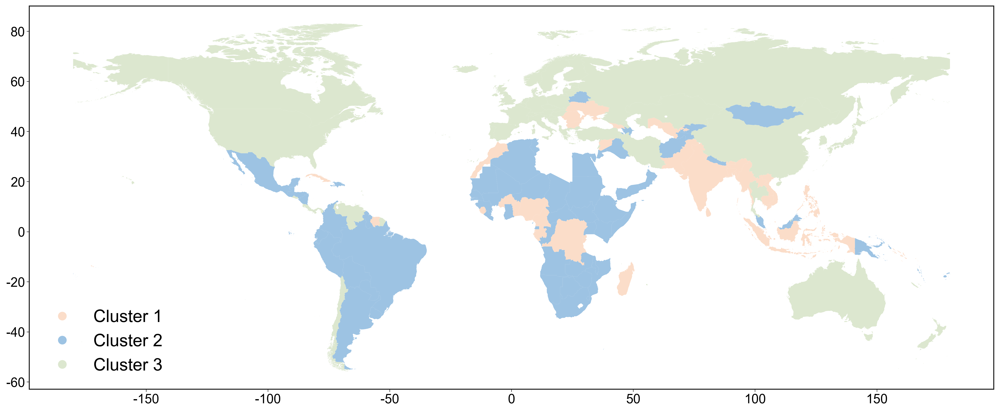

In [567]:
colors = ["#FBDDC9", "#9DC3E3", "#DCE7CF"]
cmap = mcolors.LinearSegmentedColormap.from_list("cluster_cmap", colors)

fig, ax = plt.subplots(figsize=(20, 15), dpi=300)

gdf_cluster.plot(ax=ax, column='cluster', cmap=cmap,
                 legend=True, legend_kwds={'loc': 'lower left', 'fontsize': 20,
                                           'edgecolor': 'white', 'fancybox': False,
                                           })
# ax.set_xticks([])
# ax.set_yticks([])
plt.savefig('./figures/spatial/clustering/country_cluster.png', dpi=300, bbox_inches='tight')
plt.show()

In [312]:
gdf_cluster[['ADMIN', 'ISO_A3', 'cluster']].copy().reset_index().to_csv('./data/clustering/country_clustering.csv', index=False)

### Spatial autocorrelation

In [797]:
# Moran's I for numeric variables

gdf = gpd.GeoDataFrame(df_tweets['any keyword']['country'].copy(), geometry='geometry')
y_cols = ['2012_2022_gdp_pcap_log', 'tweets_proportion_total_log', 'score_total']
for k in range(1, 6):
    for i in range(len(y_cols)):
        y_col = y_cols[i]
        print('\n'+ y_col)
        print('k: ' + str(k))
        gdf_temp = gdf.dropna(subset=[y_col])
        y = gdf_temp[y_col]
        mi, islands = compute_mi(gdf_temp, y, 'knn', k=k)


2012_2022_gdp_pcap_log
k: 1
Moran's I: 0.79952
Standard error: 0.10096
P-value: 0.00100
Z score: 8.00365

tweets_proportion_total_log
k: 1
Moran's I: 0.35651
Standard error: 0.09764
P-value: 0.00100
Z score: 3.75741

score_total
k: 1
Moran's I: 0.28208
Standard error: 0.09687
P-value: 0.00200
Z score: 2.92955

2012_2022_gdp_pcap_log
k: 2
Moran's I: 0.75058
Standard error: 0.07434
P-value: 0.00100
Z score: 10.16328

tweets_proportion_total_log
k: 2
Moran's I: 0.36833
Standard error: 0.07269
P-value: 0.00100
Z score: 5.14968

score_total
k: 2


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 38 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 38 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not full

Moran's I: 0.16244
Standard error: 0.07445
P-value: 0.01300
Z score: 2.24715

2012_2022_gdp_pcap_log
k: 3
Moran's I: 0.70442
Standard error: 0.06116
P-value: 0.00100
Z score: 11.64762

tweets_proportion_total_log
k: 3
Moran's I: 0.35833
Standard error: 0.06061
P-value: 0.00100
Z score: 6.05583

score_total
k: 3
Moran's I: 0.15105
Standard error: 0.05879
P-value: 0.00600
Z score: 2.68103

2012_2022_gdp_pcap_log
k: 4
Moran's I: 0.68748
Standard error: 0.05387
P-value: 0.00100
Z score: 12.87872

tweets_proportion_total_log
k: 4
Moran's I: 0.33970
Standard error: 0.05254
P-value: 0.00100
Z score: 6.57247

score_total
k: 4
Moran's I: 0.15604
Standard error: 0.05065
P-value: 0.00500
Z score: 3.26381

2012_2022_gdp_pcap_log
k: 5


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully 

Moran's I: 0.67464
Standard error: 0.04672
P-value: 0.00100
Z score: 14.56358

tweets_proportion_total_log
k: 5
Moran's I: 0.32781
Standard error: 0.04693
P-value: 0.00100
Z score: 7.12727

score_total
k: 5
Moran's I: 0.15905
Standard error: 0.04683
P-value: 0.00100
Z score: 3.54229


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\scipy\sparse\_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [888]:
# Join count for binary variables

# Convert categorical variable to dummy variables
gdf_cluster_binary = gdf_cluster.copy()
gdf_cluster_binary.dropna(subset=['cluster'], inplace=True)
gdf_cluster_binary.reset_index(inplace=True)
gdf_cluster_binary = pd.get_dummies(gdf_cluster_binary, columns=['cluster'])
# Conver dummy variables to binary variables
gdf_cluster_binary['cluster_Cluster 1'] = gdf_cluster_binary['cluster_Cluster 1'].apply(lambda x: 1 if x == 1 else 0)
gdf_cluster_binary['cluster_Cluster 2'] = gdf_cluster_binary['cluster_Cluster 2'].apply(lambda x: 1 if x == 1 else 0)
gdf_cluster_binary['cluster_Cluster 3'] = gdf_cluster_binary['cluster_Cluster 3'].apply(lambda x: 1 if x == 1 else 0)

# Set
weight_option = 'knn'

# # Drop islands
# _, islands = compute_jc(gdf_cluster_binary, gdf_cluster_binary['cluster_Cluster 1'], 'knn', k=2)
# gdf_cluster_binary.drop(islands, inplace=True)

# Compute jc
y_cols = ['cluster_Cluster 1', 'cluster_Cluster 2', 'cluster_Cluster 3']
for k in range(1, 6):
    for i in range(len(y_cols)):
        y_col = y_cols[i]
        print('\n'+ y_col)
        print('k: ' + str(k))
        y = gdf_cluster_binary[y_col]
        compute_jc(gdf_cluster_binary, y, weight_option, k=k)




cluster_Cluster 1
k: 1


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 38 disconnected components.
  warnings.warn(message)


Chi-square statistic: 4.700
Analytical p-value for chi2: 0.030
P-value for chi2 under random spatial permutations: 0.005

cluster_Cluster 2
k: 1


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 38 disconnected components.
  warnings.warn(message)


Chi-square statistic: 5.686
Analytical p-value for chi2: 0.017
P-value for chi2 under random spatial permutations: 0.003

cluster_Cluster 3
k: 1


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 38 disconnected components.
  warnings.warn(message)


Chi-square statistic: 22.697
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 1
k: 2


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 8 disconnected components.
  warnings.warn(message)


Chi-square statistic: 7.298
Analytical p-value for chi2: 0.007
P-value for chi2 under random spatial permutations: 0.004

cluster_Cluster 2
k: 2


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 8 disconnected components.
  warnings.warn(message)


Chi-square statistic: 15.614
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 3
k: 2


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 8 disconnected components.
  warnings.warn(message)


Chi-square statistic: 38.920
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 1
k: 3


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 10.980
Analytical p-value for chi2: 0.001
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 2
k: 3


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 19.548
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 3
k: 3


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 46.047
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 1
k: 4


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 12.285
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 2
k: 4


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 25.459
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 3
k: 4


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 66.707
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 1
k: 5


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 12.159
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 2
k: 5


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 27.293
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001

cluster_Cluster 3
k: 5


c:\ProgramData\Anaconda3\envs\NLP\lib\site-packages\libpysal\weights\weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


Chi-square statistic: 72.755
Analytical p-value for chi2: 0.000
P-value for chi2 under random spatial permutations: 0.001


## 4.8 Topic Modeling

In [962]:
def load_topic_cluster(file_path):
    df_topic_test = pd.read_csv(file_path)
    df_topic_test.drop(columns=['Unnamed: 0', 'ISO_A3', 'cluster'], inplace=True)
    topic_year = df_topic_test.groupby(['year']).agg('mean').reset_index()
    topic_year['year'] = pd.to_datetime(topic_year['year'], format='%Y')
    topic_year['year'] = topic_year['year'].dt.to_period('Y')
    topic_year.set_index('year', inplace=True)

    return topic_year

def plot_bar(topic_year, cluster_id, ax):
   
    topic_year.plot.bar(ax=ax, width=0.8, cmap='tab20c', edgecolor='white', linewidth=0.2)
    # legend
    ax.legend(bbox_to_anchor=(1, 1), loc='upper left', fontsize=15)
    # x-stick, y-stick
    ax.tick_params(axis='x', rotation=0, labelsize=15)
    ax.tick_params(axis='y', labelsize=15)

    # x-label, y-label
    ax.set_xlabel('Year', fontsize=20)
    ax.set_ylabel('Topic probability', fontsize=20)
    # subtitle
    ax.set_title('Cluster ' + cluster_id, fontsize=25)

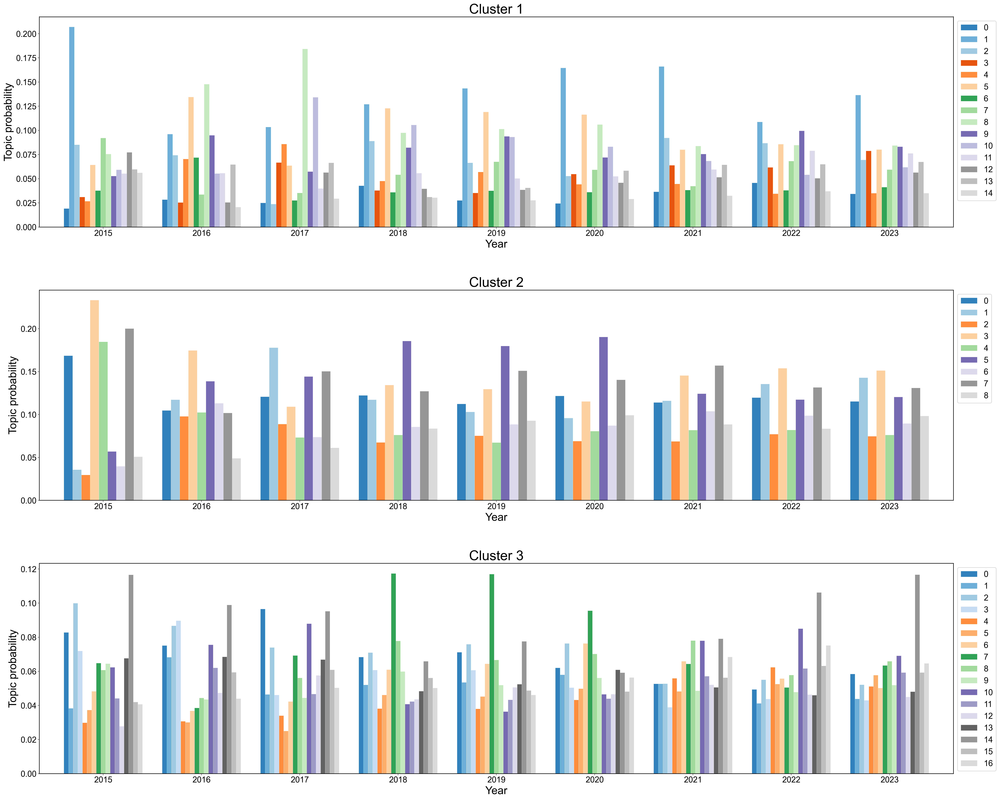

In [1212]:
topic_cluster_dict = {
    '1': './data/topic_modeling/cluster_0.0.csv',
    '2': './data/topic_modeling/cluster_1.0.csv',
    '3': './data/topic_modeling/cluster_2.0.csv'
}

fig, axes = plt.subplots(3, 1, figsize=(30, 25), dpi=300)
plt.subplots_adjust(hspace=0.3)

for cluster_id, file_path in topic_cluster_dict.items():
    topic_year = load_topic_cluster(file_path)
    topic_year = topic_year[topic_year.index > '2014']
    ax = axes[int(cluster_id)-1]
    subtitle = 'Cluster ' + cluster_id
    plot_bar(topic_year, cluster_id, ax)

plt.savefig('./figures/topic_modeling/topic_probability_across_years.png', dpi=300, bbox_inches='tight')